In [1]:
import time
import numpy as np
import matplotlib.pyplot as plt

import sys
sys.path.insert(0, './')

def generateModelV2(working_directory, 
                    number_directory=0, 
                    number_images=0,
                    #number_cluster=10,
                    descriptor_generator="SIFT", 
                    number_feature=200,
                    minimum_size_descriptor=20, 
                    #mode_affichage=""
                   ):
    start_time_model = time.time()

    # class de travail
    from Python.automaticImageIndexing import AutomaticImageIndexing
    automaticImageIndexing = AutomaticImageIndexing()

    print(''.join(['Version : ', automaticImageIndexing.version()]))
    print(''.join(['Data directory : ', automaticImageIndexing.data_directory]))

    automaticImageIndexing.n_limite_directories = number_directory
    automaticImageIndexing.n_limite_images = number_images
    print(''.join(['Max Number of directory : ', str(automaticImageIndexing.n_limite_directories)]))
    print(''.join(['Max Number of picture by directory : ', str(automaticImageIndexing.n_limite_images)]))

    automaticImageIndexing.working_directory = working_directory#'C:/Users/naru_/OneDrive/Documents/openclassroom/P7 traitement image/'
    automaticImageIndexing.annotation_directory = 'annotation/'
    automaticImageIndexing.picture_directory = 'images/'
    
    automaticImageIndexing.feature_generator = descriptor_generator
    print('Generator : %s' % automaticImageIndexing.feature_generator)
    automaticImageIndexing.n_feature = number_feature 
    print('Number of feature : %d' % automaticImageIndexing.n_feature)
    automaticImageIndexing.feature_size_min = minimum_size_descriptor
    print('Minimum feature size  %d' % automaticImageIndexing.n_feature)
    
    automaticImageIndexing.read_picture_and_feature_generation(with_sub_picture=True, descriptor_generator=descriptor_generator)
    print("Temps d execution apres parcour image + sift : %s secondes ---" % (time.time() - start_time_model))

    return automaticImageIndexing

def generateCluster(automaticImageIndexing, number_cluster=None, mode_affichage="", number_cluster_to_show=None):
    start_time_cluster = time.time()
    if(number_cluster is None):
        number_cluster = int(10)
    automaticImageIndexing.n_clusters = number_cluster
    
    automaticImageIndexing.clusturing(automaticImageIndexing.n_clusters)
    print("Temps d execution apres Clustering : %s secondes ---" % (time.time() - start_time_cluster))
    mega_histo = automaticImageIndexing.developBagOfVisualWord()
    print("Temps d execution apres BOV : %s secondes ---" % (time.time() - start_time_cluster))
    automaticImageIndexing.plotHist(mega_histo, automaticImageIndexing.n_clusters, None)
    print("Temps d execution après plot BOV : %s secondes ---" % (time.time() - start_time_cluster))

    if number_cluster_to_show is None :
        number_cluster_to_show = int(number_cluster/2)
        
    if (mode_affichage == "subplot" or mode_affichage == "all"):
        print("affichage subplot des images liées au cluster %d" % number_cluster_to_show)
        automaticImageIndexing.plot_descriptor_in_cluster_subplot_V2(number_cluster_to_show)
        print("Temps d execution apres subplot : %s secondes ---" % (time.time() - start_time_cluster))
    
    if (mode_affichage == "individual_plot" or mode_affichage == "all"):
        print("affichage individuel des images liées au cluster %d" % number_cluster_to_show)
        automaticImageIndexing.plot_descriptor_in_cluster_individualplot(number_cluster_to_show)        
        print("Temps d execution apres individual_plot : %s secondes ---" % (time.time() - start_time_cluster))
    print("Temps d execution cluster : %s secondes ---" % (time.time() - start_time_cluster))

def showClusterPicture(automaticImageIndexing, mode_affichage="", number_cluster_to_show=None):
    start_time_showing = time.time()

    if automaticImageIndexing.n_clusters is None:
        print("Veuillez entrainer le model (& generer les cluster) ---")
    else:
        if number_cluster_to_show is None :
            number_cluster_to_show = int(automaticImageIndexing.n_clusters/2)

        if (mode_affichage == "subplot" or mode_affichage == "all"):
            print("affichage subplot des images liées au cluster %d" % number_cluster_to_show)
            automaticImageIndexing.plot_descriptor_in_cluster_subplot_V2(number_cluster_to_show)
            print("Temps d execution apres subplot : %s secondes ---" % (time.time() - start_time_showing))

        if (mode_affichage == "individual_plot" or mode_affichage == "all"):
            print("affichage individuel des images liées au cluster %d" % number_cluster_to_show)
            automaticImageIndexing.plot_descriptor_in_cluster_individualplot(number_cluster_to_show)        
            print("Temps d execution apres individual_plot : %s secondes ---" % (time.time() - start_time_showing))
    

Version : 0.2
Data directory : Data/
Max Number of directory : 40
Max Number of picture by directory : 2
Generator : ORB
Number of feature : 500
Minimum feature size  500
Computing Features for  n02085620-Chihuahua
Computing Features for  n02085782-Japanese_spaniel
Computing Features for  n02085936-Maltese_dog
Computing Features for  n02086079-Pekinese
Computing Features for  n02086240-Shih-Tzu
Computing Features for  n02086646-Blenheim_spaniel
Computing Features for  n02086910-papillon
Computing Features for  n02087046-toy_terrier
Computing Features for  n02087394-Rhodesian_ridgeback
Computing Features for  n02088094-Afghan_hound
Computing Features for  n02088238-basset
Computing Features for  n02088364-beagle
Computing Features for  n02088466-bloodhound
Computing Features for  n02088632-bluetick
Computing Features for  n02089078-black-and-tan_coonhound
Computing Features for  n02089867-Walker_hound
Computing Features for  n02089973-English_foxhound
Computing Features for  n02090379-r

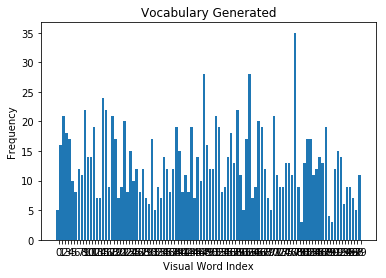

Temps d execution après plot BOV : 93.5989999771 secondes ---
Temps d execution cluster : 93.6000001431 secondes ---
affichage subplot des images liées au cluster 50
-------
408
80
-------


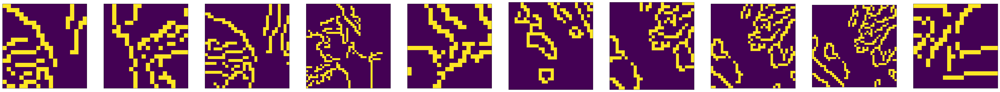

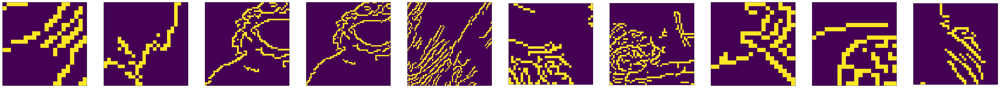

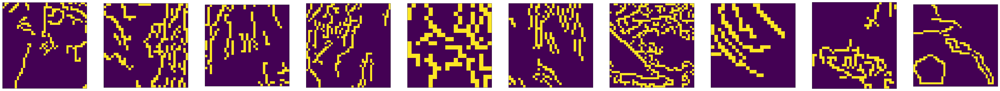

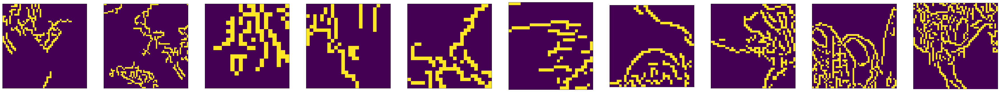

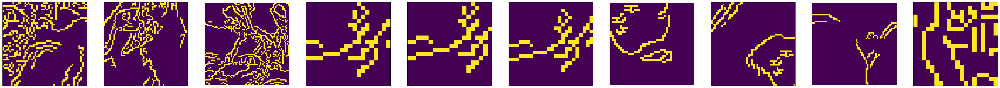

...

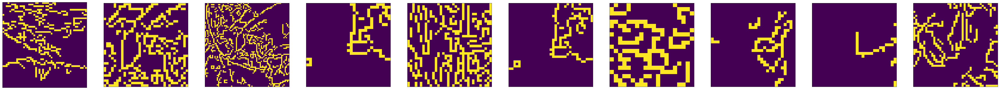

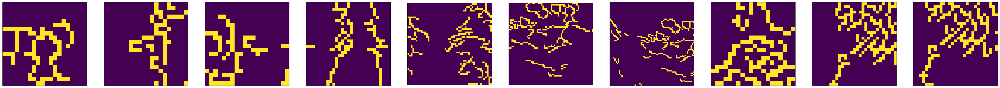

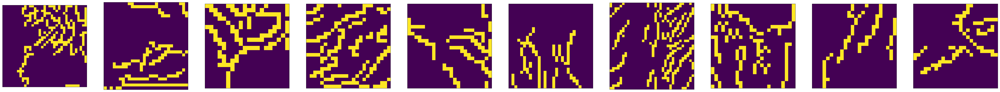

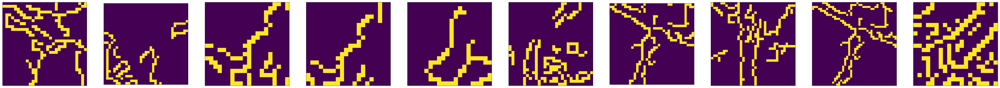

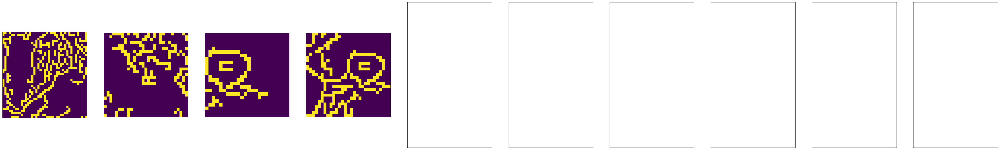

Temps d execution apres subplot : 37.1689999104 secondes ---
--------------------------------- start test cluster 100 ---------------------------------
-----------------------------------------------------------------------------------------
--------------------------------- start test cluster 200 ---------------------------------
Temps d execution apres Clustering : 185.794999838 secondes ---
Vocabulary Histogram Generated
Temps d execution apres BOV : 185.798999786 secondes ---
Plotting histogram


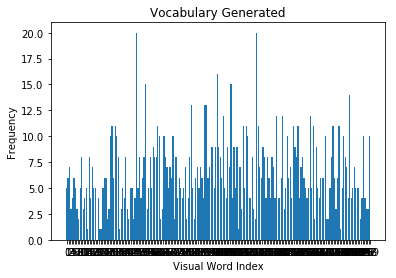

Temps d execution après plot BOV : 187.980999947 secondes ---
Temps d execution cluster : 187.980999947 secondes ---
affichage subplot des images liées au cluster 100
-------
96
80
-------


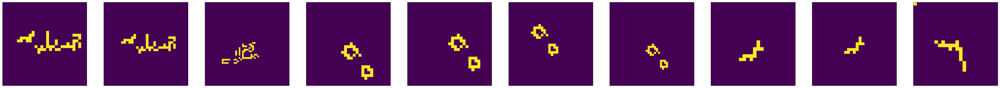

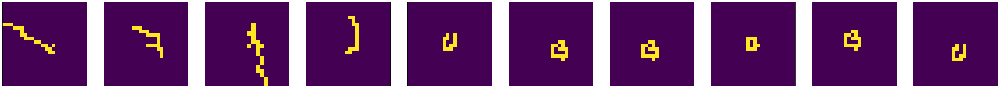

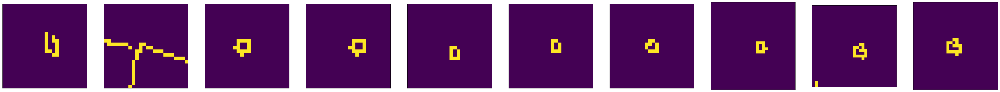

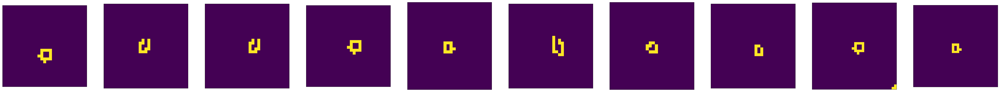

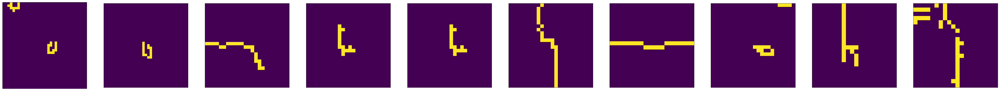

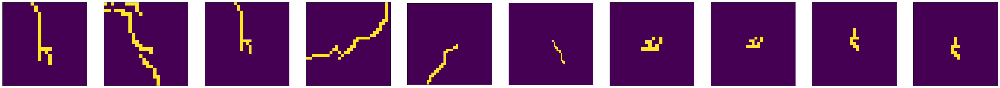

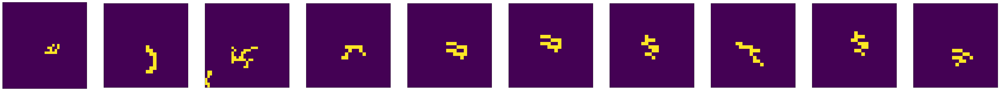

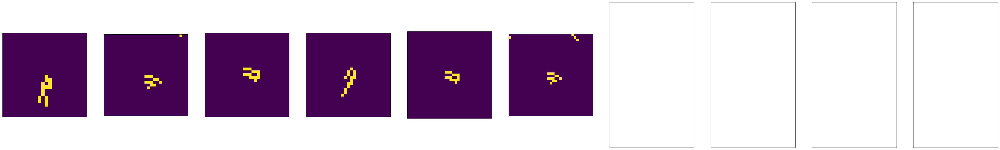

Temps d execution apres subplot : 8.75699996948 secondes ---
--------------------------------- start test cluster 200 ---------------------------------
-----------------------------------------------------------------------------------------
--------------------------------- start test cluster 300 ---------------------------------
Temps d execution apres Clustering : 183.003000021 secondes ---
Vocabulary Histogram Generated
Temps d execution apres BOV : 183.006999969 secondes ---
Plotting histogram


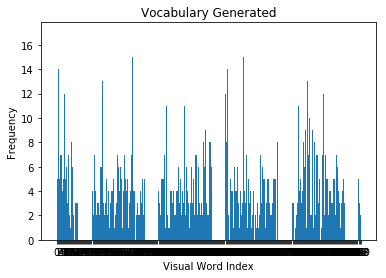

Temps d execution après plot BOV : 185.492000103 secondes ---
Temps d execution cluster : 185.493000031 secondes ---
affichage subplot des images liées au cluster 150
-------
120
80
-------


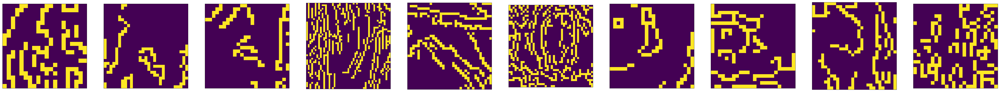

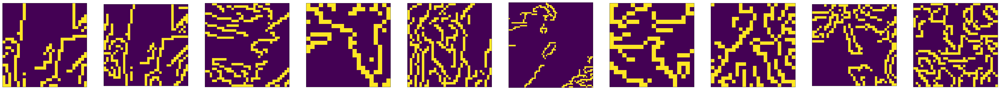

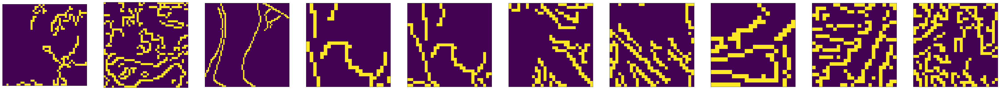

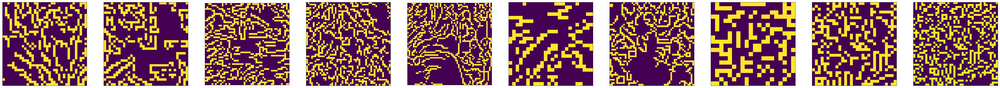

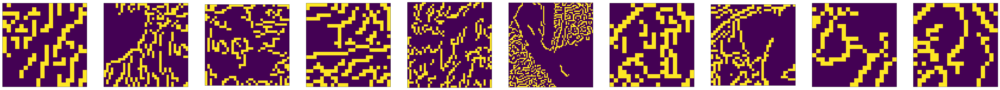

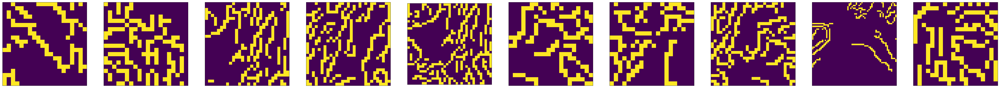

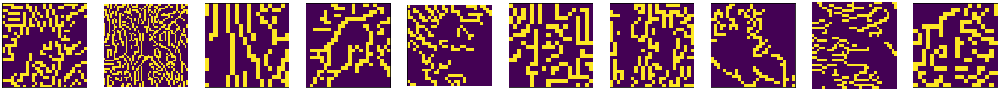

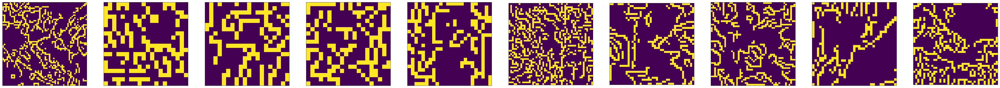

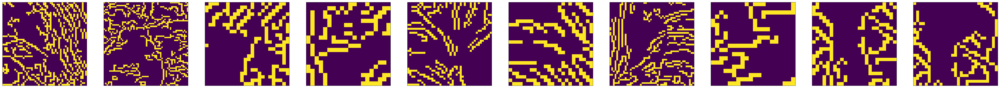

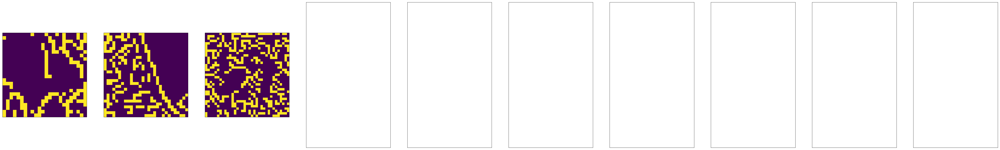

Temps d execution apres subplot : 9.83999991417 secondes ---
--------------------------------- start test cluster 300 ---------------------------------
-----------------------------------------------------------------------------------------
--------------------------------- start test cluster 400 ---------------------------------
Temps d execution apres Clustering : 272.657999992 secondes ---
Vocabulary Histogram Generated
Temps d execution apres BOV : 272.664000034 secondes ---
Plotting histogram


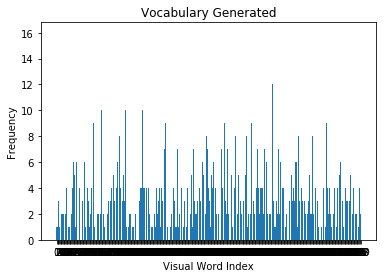

Temps d execution après plot BOV : 277.525000095 secondes ---
Temps d execution cluster : 277.525000095 secondes ---
affichage subplot des images liées au cluster 200
-------
156
80
-------


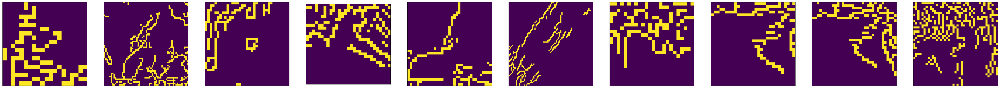

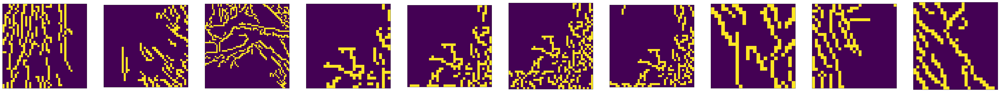

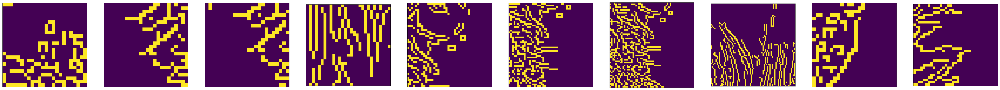

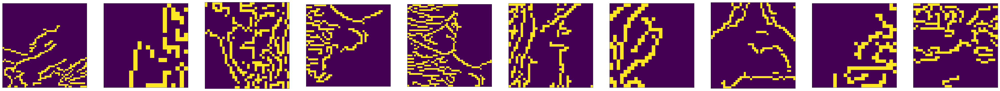

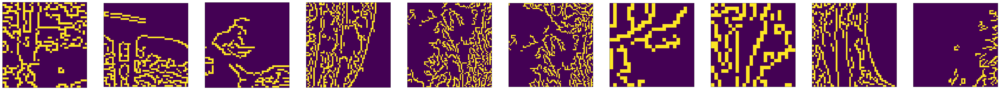

...

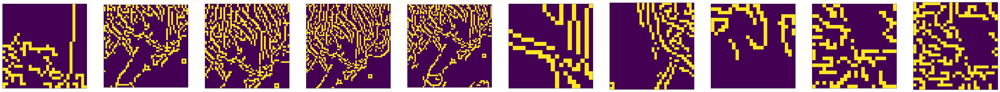

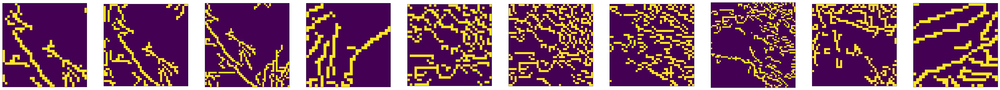

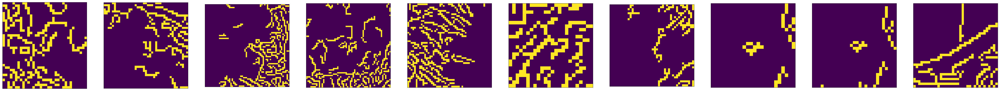

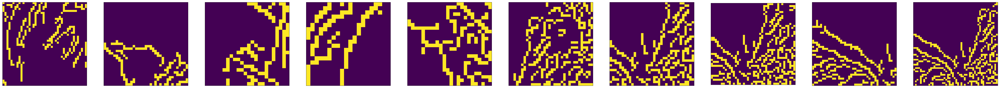

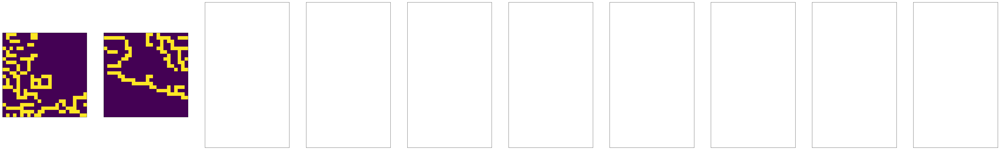

Temps d execution apres subplot : 16.5850000381 secondes ---
--------------------------------- start test cluster 400 ---------------------------------
-----------------------------------------------------------------------------------------
--------------------------------- start test cluster 500 ---------------------------------
Temps d execution apres Clustering : 324.267000198 secondes ---
Vocabulary Histogram Generated
Temps d execution apres BOV : 324.270000219 secondes ---
Plotting histogram


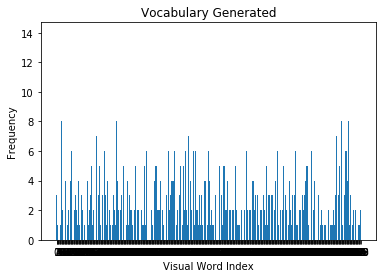

Temps d execution après plot BOV : 327.703000069 secondes ---
Temps d execution cluster : 327.703000069 secondes ---
affichage subplot des images liées au cluster 250
-------
132
80
-------


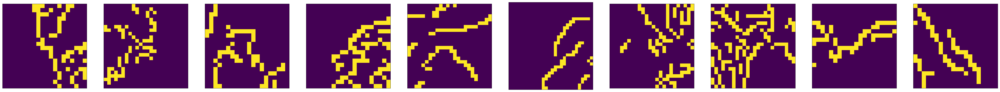

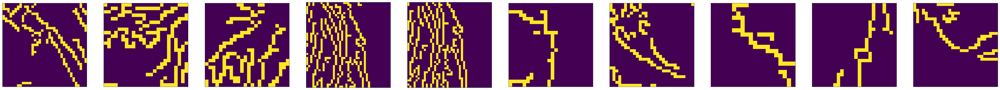

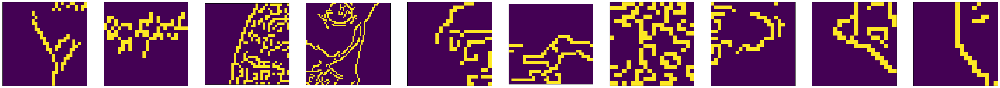

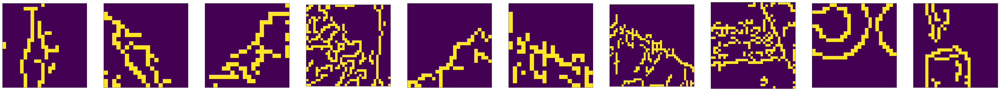

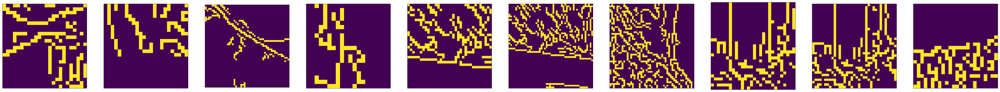

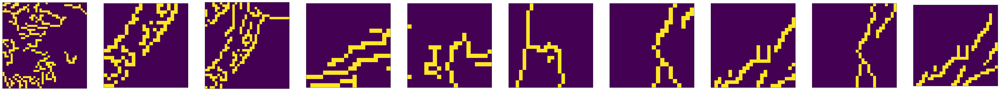

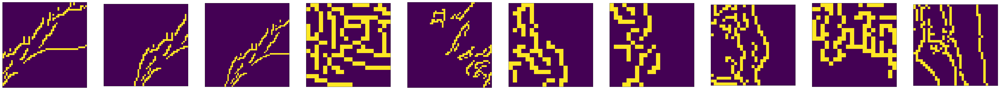

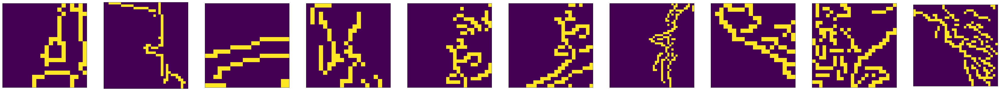

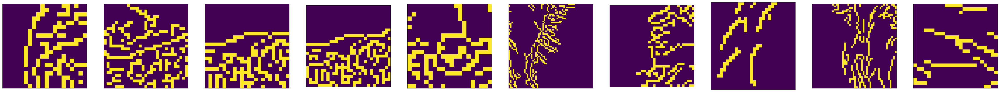

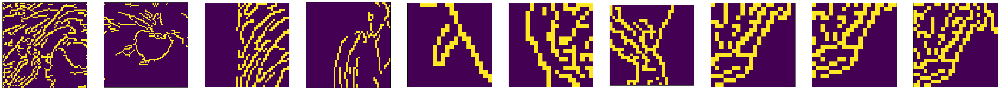

Temps d execution apres subplot : 9.47699999809 secondes ---
--------------------------------- start test cluster 500 ---------------------------------
-----------------------------------------------------------------------------------------
--------------------------------- start test cluster 600 ---------------------------------
Temps d execution apres Clustering : 245.815000057 secondes ---
Vocabulary Histogram Generated
Temps d execution apres BOV : 245.819000006 secondes ---
Plotting histogram


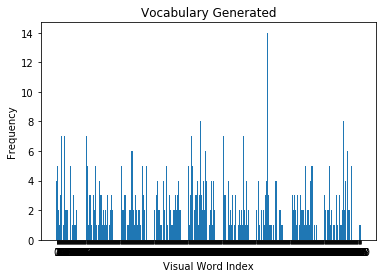

Temps d execution après plot BOV : 250.398000002 secondes ---
Temps d execution cluster : 250.398999929 secondes ---
affichage subplot des images liées au cluster 300
-------
72
80
-------


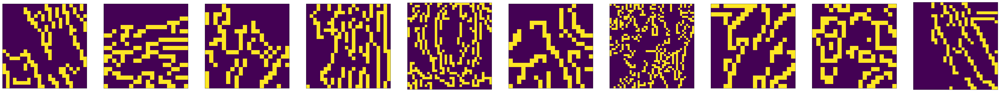

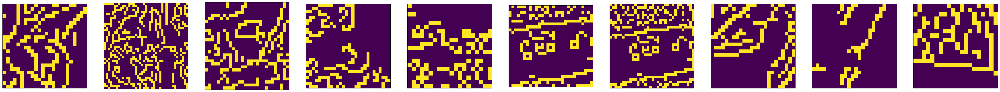

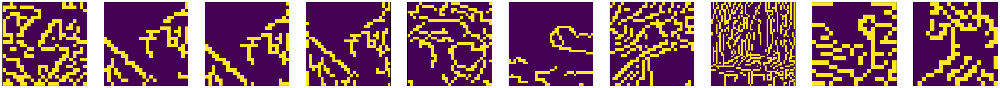

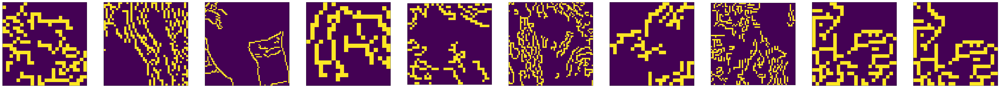

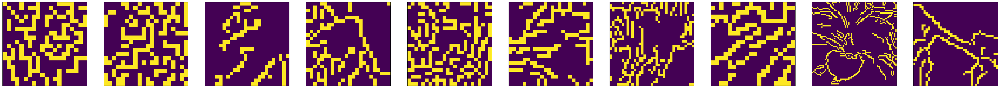

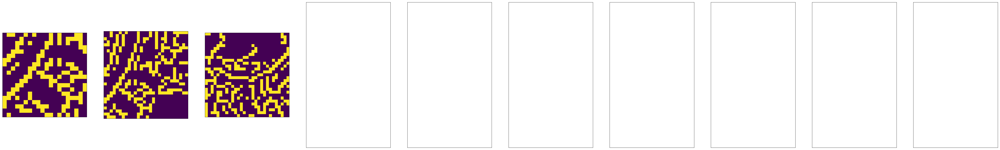

Temps d execution apres subplot : 5.59800004959 secondes ---
--------------------------------- start test cluster 600 ---------------------------------
-----------------------------------------------------------------------------------------
--------------------------------- start test cluster 700 ---------------------------------
Temps d execution apres Clustering : 305.738000154 secondes ---
Vocabulary Histogram Generated
Temps d execution apres BOV : 305.742000103 secondes ---
Plotting histogram


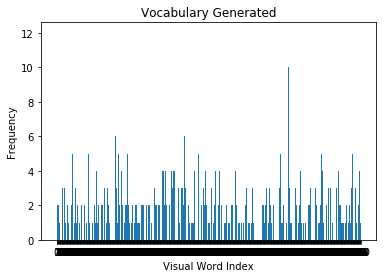

Temps d execution après plot BOV : 314.464000225 secondes ---
Temps d execution cluster : 314.465000153 secondes ---
affichage subplot des images liées au cluster 350
-------
48
80
-------


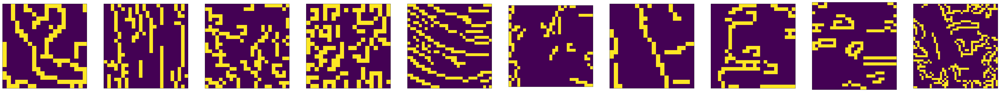

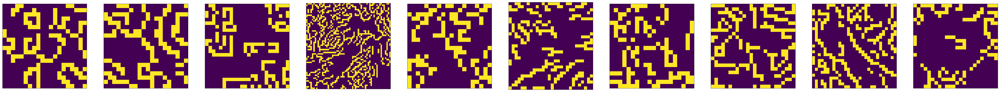

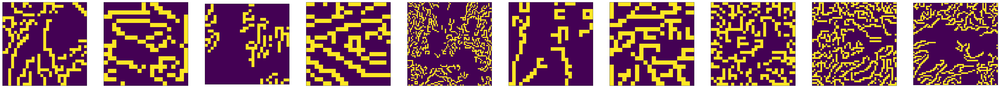

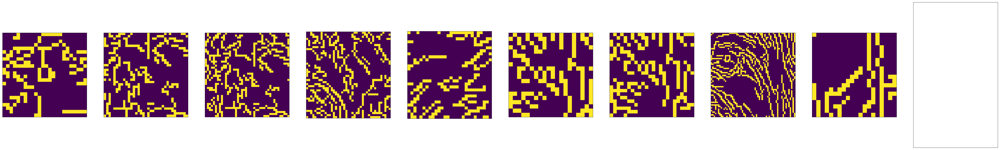

Temps d execution apres subplot : 5.73199987411 secondes ---
--------------------------------- start test cluster 700 ---------------------------------
-----------------------------------------------------------------------------------------
--------------------------------- start test cluster 800 ---------------------------------
Temps d execution apres Clustering : 354.481999874 secondes ---
Vocabulary Histogram Generated
Temps d execution apres BOV : 354.481999874 secondes ---
Plotting histogram


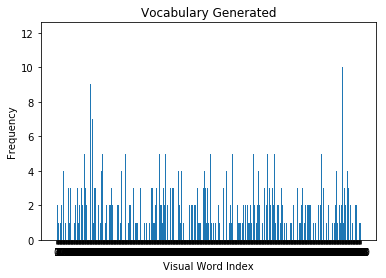

Temps d execution après plot BOV : 360.572999954 secondes ---
Temps d execution cluster : 360.572999954 secondes ---
affichage subplot des images liées au cluster 400
-------
60
80
-------


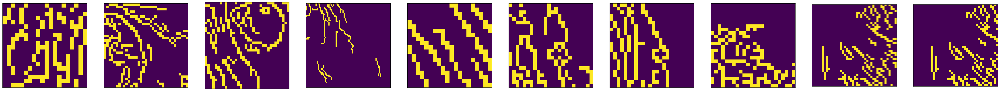

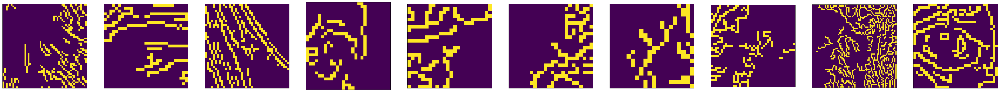

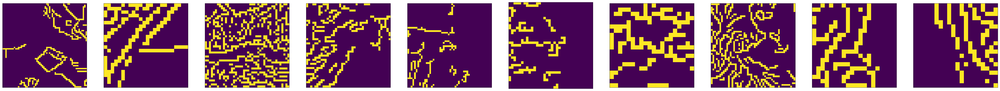

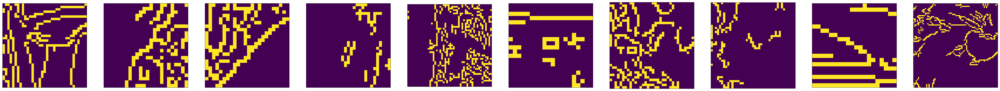

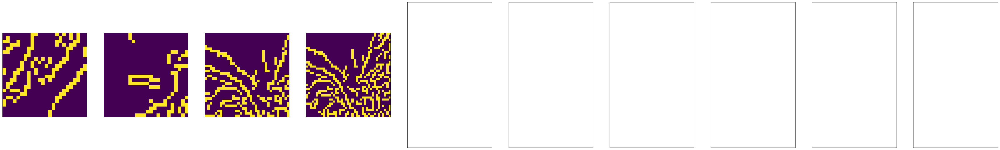

Temps d execution apres subplot : 5.05400013924 secondes ---
--------------------------------- start test cluster 800 ---------------------------------
-----------------------------------------------------------------------------------------
--------------------------------- start test cluster 900 ---------------------------------
Temps d execution apres Clustering : 384.476999998 secondes ---
Vocabulary Histogram Generated
Temps d execution apres BOV : 384.486000061 secondes ---
Plotting histogram


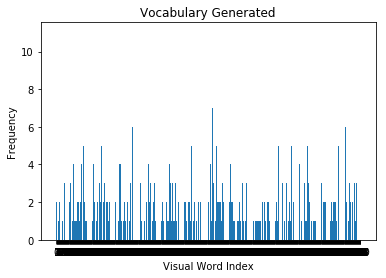

Temps d execution après plot BOV : 394.765000105 secondes ---
Temps d execution cluster : 394.766000032 secondes ---
affichage subplot des images liées au cluster 450
-------
60
80
-------


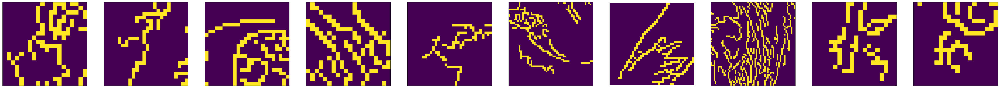

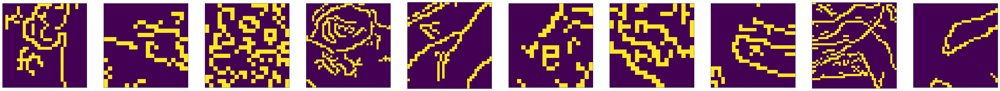

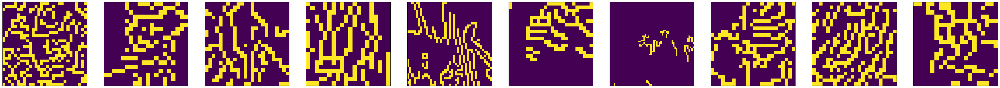

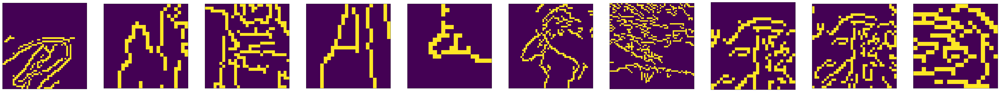

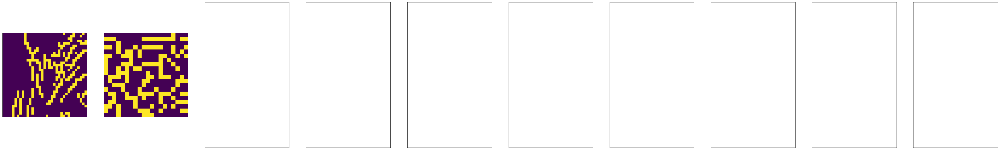

Temps d execution apres subplot : 5.80500006676 secondes ---
--------------------------------- start test cluster 900 ---------------------------------


In [2]:
working_space = 'C:/Users/naru_/OneDrive/Documents/openclassroom/P7 traitement image/'
model = generateModelV2(
        working_directory=working_space,
        number_feature=500,
        number_directory=40, 
        number_images=2,#20,
        descriptor_generator="ORB",
        minimum_size_descriptor=20
    )

start = 100
stop = 1000
step = 100

for nb_test in range(start, stop, step):
    print("-----------------------------------------------------------------------------------------")
    print("--------------------------------- start test cluster %s ---------------------------------" % str(nb_test))
    generateCluster(
        model,
        number_cluster=nb_test
    )
    showClusterPicture(
        model,
        mode_affichage="subplot",
        number_cluster_to_show=None
    )
    print("--------------------------------- start test cluster %s ---------------------------------" % str(nb_test))

Version : 0.2
Data directory : Data/
Max Number of directory : 0
Max Number of picture by directory : 2
Generator : ORB
Number of feature : 500
Minimum feature size  500
Computing Features for  n02085620-Chihuahua
Computing Features for  n02085782-Japanese_spaniel
Computing Features for  n02085936-Maltese_dog
Computing Features for  n02086079-Pekinese
Computing Features for  n02086240-Shih-Tzu
Computing Features for  n02086646-Blenheim_spaniel
Computing Features for  n02086910-papillon
Computing Features for  n02087046-toy_terrier
Computing Features for  n02087394-Rhodesian_ridgeback
Computing Features for  n02088094-Afghan_hound
Computing Features for  n02088238-basset
Computing Features for  n02088364-beagle
Computing Features for  n02088466-bloodhound
Computing Features for  n02088632-bluetick
Computing Features for  n02089078-black-and-tan_coonhound
Computing Features for  n02089867-Walker_hound
Computing Features for  n02089973-English_foxhound
Computing Features for  n02090379-re

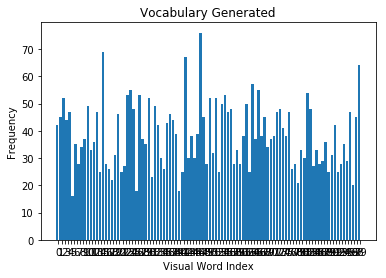

Temps d execution après plot BOV : 679.855999947 secondes ---
Temps d execution cluster : 679.856999874 secondes ---
affichage subplot des images liées au cluster 50
-------
1188
80
-------


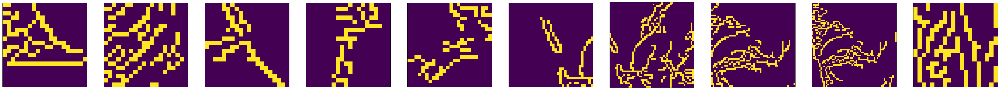

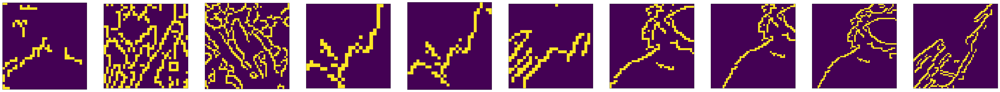

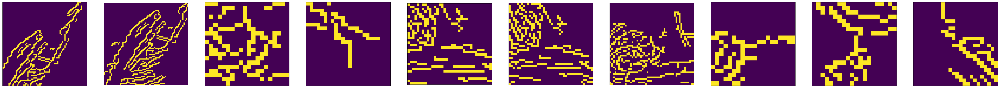

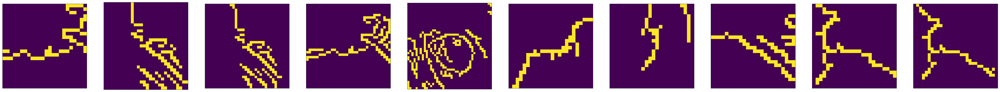

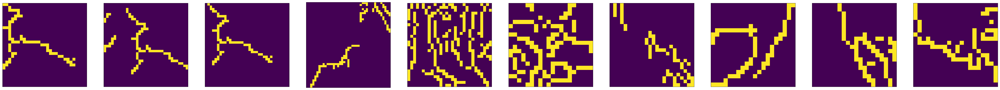

...

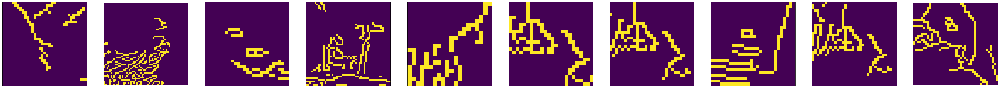

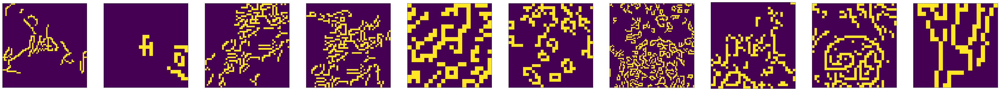

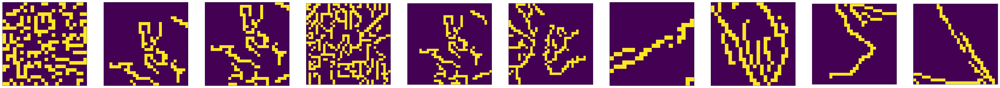

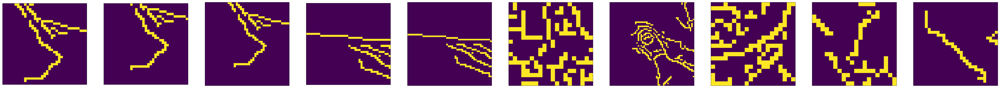

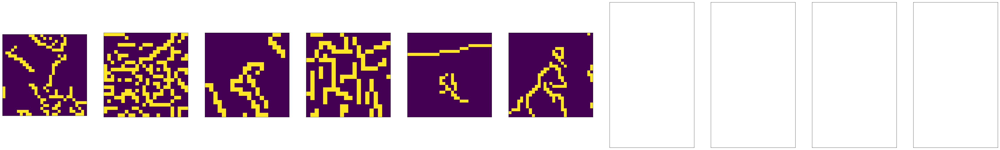

Temps d execution apres subplot : 122.006000042 secondes ---
--------------------------------- start test cluster 100 ---------------------------------
-----------------------------------------------------------------------------------------
--------------------------------- start test cluster 200 ---------------------------------
Temps d execution apres Clustering : 989.128000021 secondes ---
Vocabulary Histogram Generated
Temps d execution apres BOV : 989.154000044 secondes ---
Plotting histogram


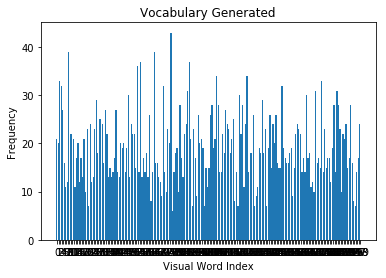

Temps d execution après plot BOV : 990.68900013 secondes ---
Temps d execution cluster : 990.690000057 secondes ---
affichage subplot des images liées au cluster 100
-------
468
80
-------


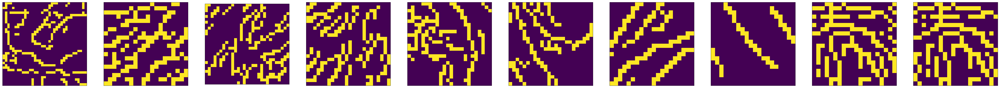

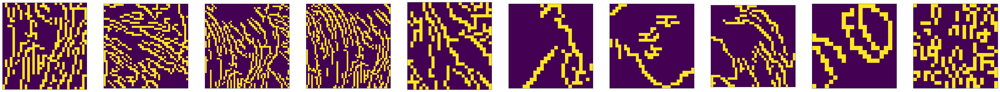

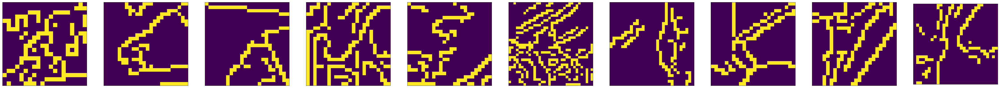

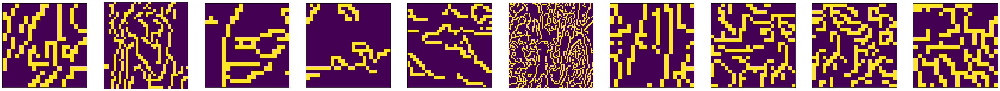

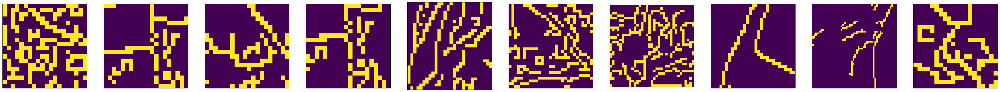

...

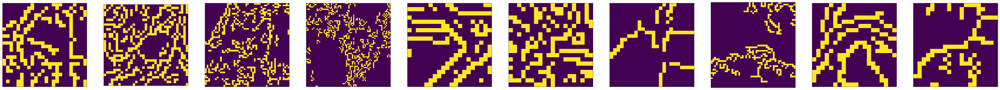

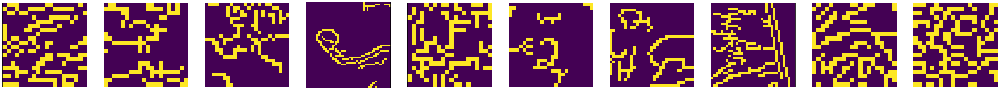

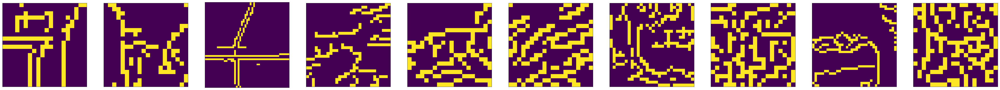

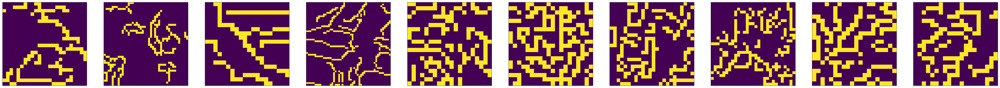

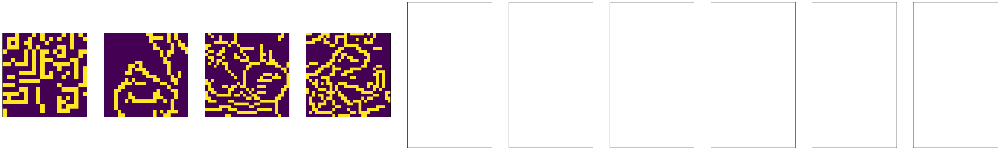

Temps d execution apres subplot : 33.9430000782 secondes ---
--------------------------------- start test cluster 200 ---------------------------------
-----------------------------------------------------------------------------------------
--------------------------------- start test cluster 300 ---------------------------------
Temps d execution apres Clustering : 999.642000198 secondes ---
Vocabulary Histogram Generated
Temps d execution apres BOV : 999.651000023 secondes ---
Plotting histogram


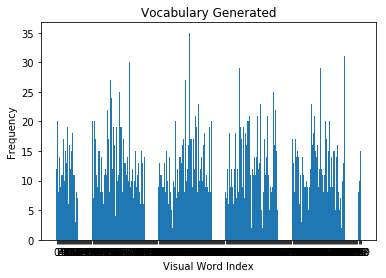

Temps d execution après plot BOV : 1001.85600019 secondes ---
Temps d execution cluster : 1001.85700011 secondes ---
affichage subplot des images liées au cluster 150
-------
348
80
-------


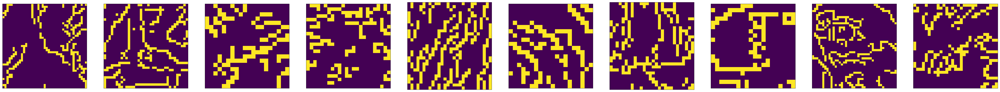

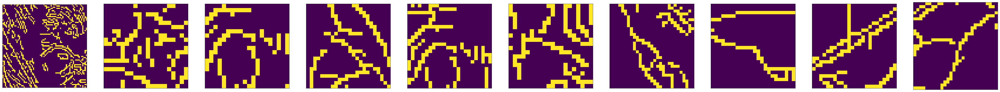

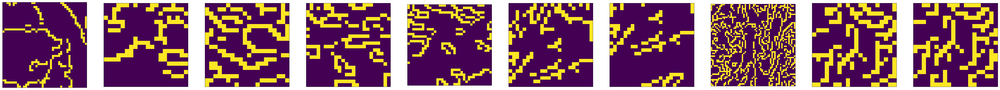

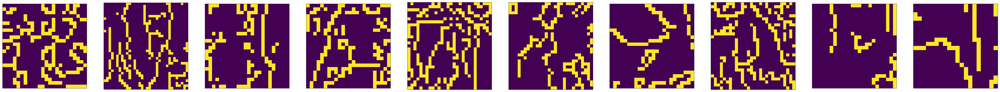

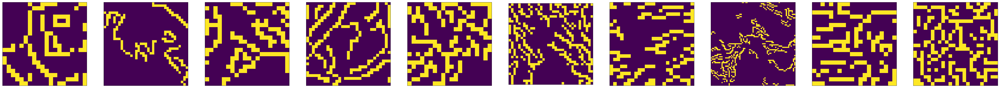

...

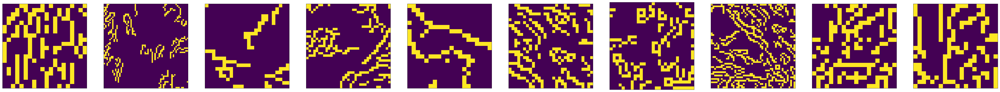

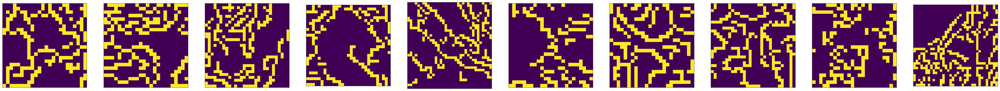

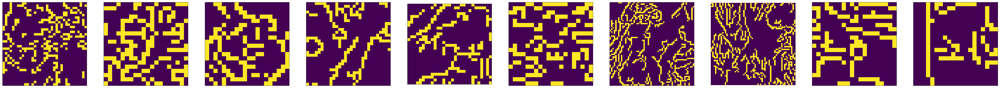

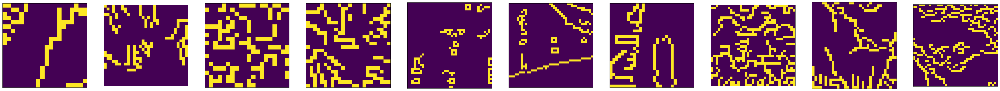

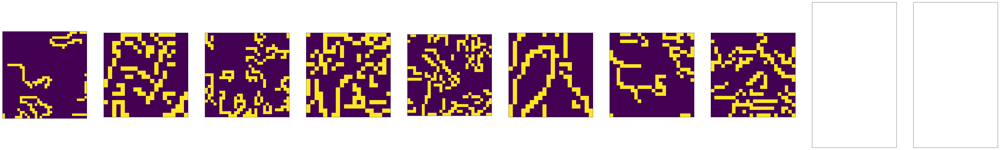

Temps d execution apres subplot : 25.6080000401 secondes ---
--------------------------------- start test cluster 300 ---------------------------------
-----------------------------------------------------------------------------------------
--------------------------------- start test cluster 400 ---------------------------------
Temps d execution apres Clustering : 1181.98900008 secondes ---
Vocabulary Histogram Generated
Temps d execution apres BOV : 1181.99500012 secondes ---
Plotting histogram


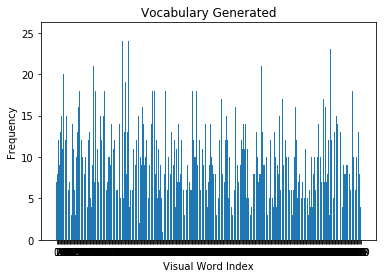

Temps d execution après plot BOV : 1184.78900003 secondes ---
Temps d execution cluster : 1184.78999996 secondes ---
affichage subplot des images liées au cluster 200
-------
312
80
-------


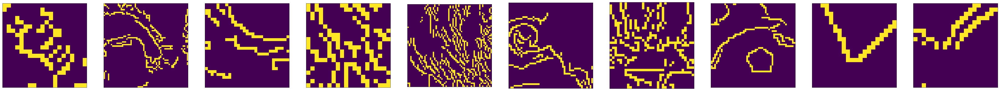

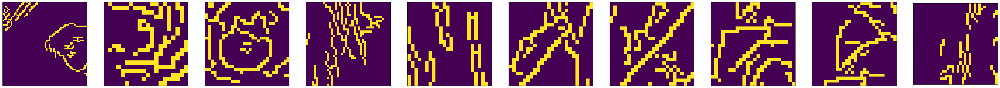

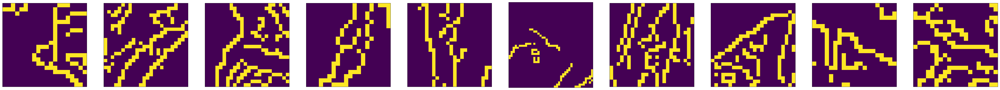

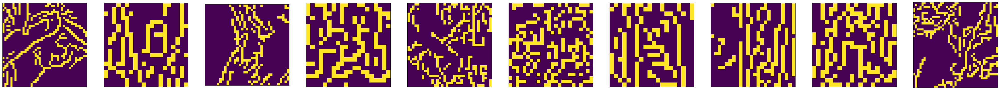

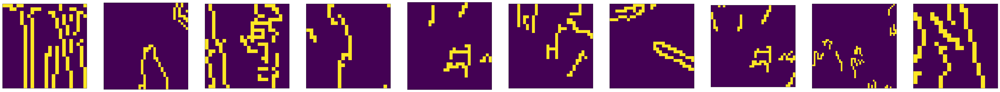

...

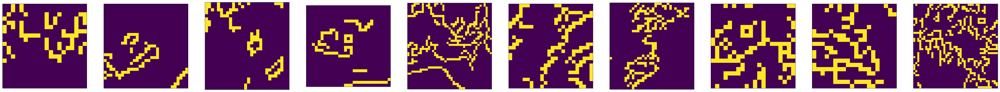

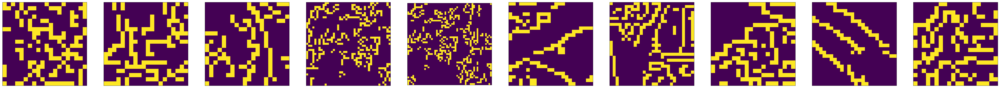

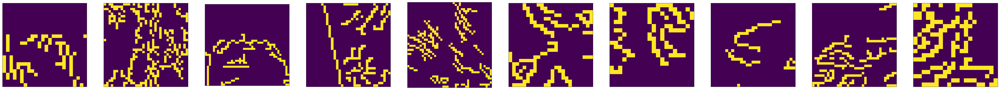

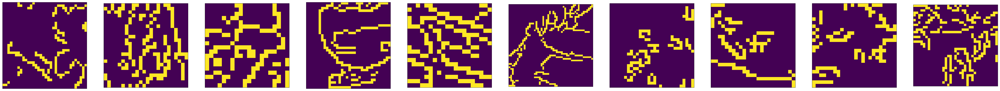

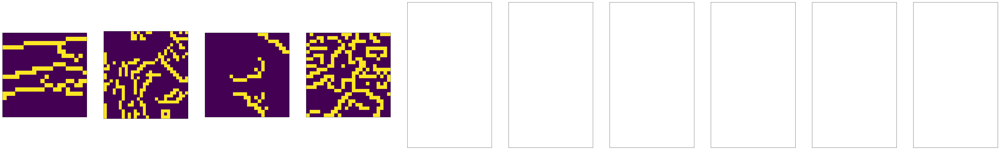

Temps d execution apres subplot : 22.3210000992 secondes ---
--------------------------------- start test cluster 400 ---------------------------------
-----------------------------------------------------------------------------------------
--------------------------------- start test cluster 500 ---------------------------------
Temps d execution apres Clustering : 1366.83999991 secondes ---
Vocabulary Histogram Generated
Temps d execution apres BOV : 1366.84899998 secondes ---
Plotting histogram


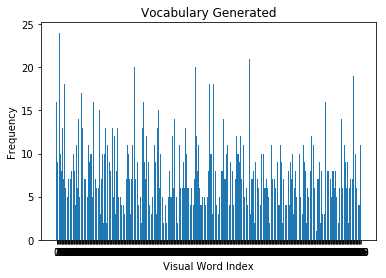

Temps d execution après plot BOV : 1370.2750001 secondes ---
Temps d execution cluster : 1370.27600002 secondes ---
affichage subplot des images liées au cluster 250
-------
264
80
-------


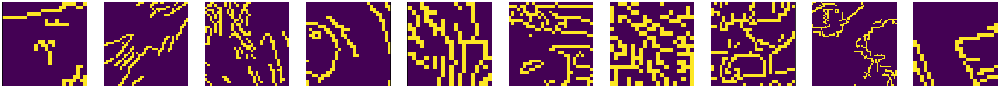

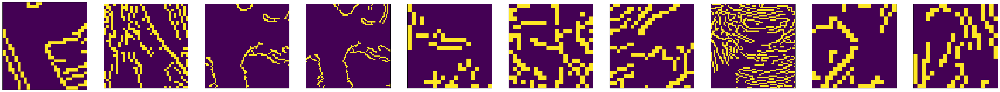

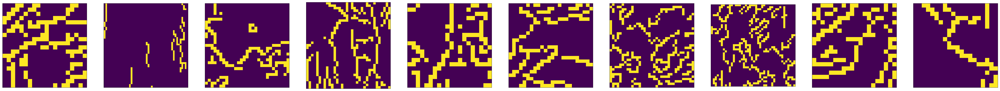

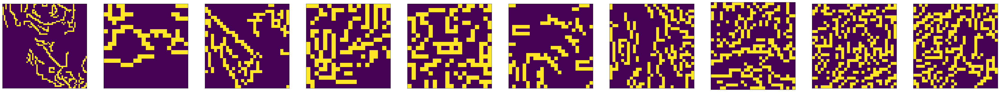

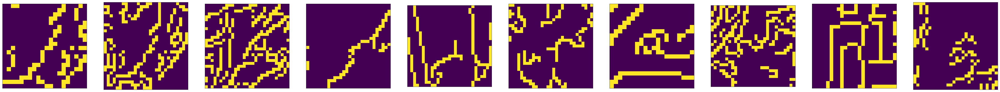

...

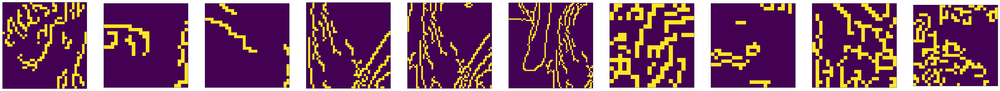

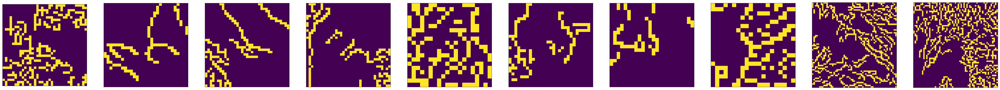

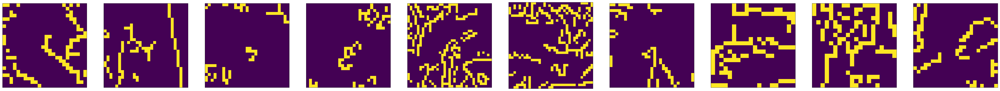

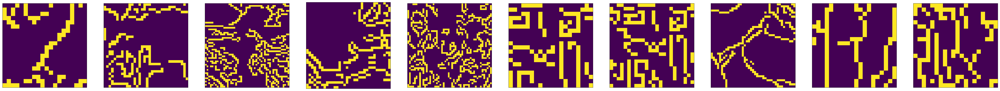

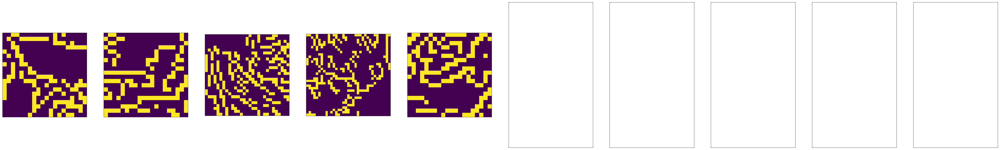

Temps d execution apres subplot : 19.6370000839 secondes ---
--------------------------------- start test cluster 500 ---------------------------------
-----------------------------------------------------------------------------------------
--------------------------------- start test cluster 600 ---------------------------------
Temps d execution apres Clustering : 1514.41100001 secondes ---
Vocabulary Histogram Generated
Temps d execution apres BOV : 1514.41999984 secondes ---
Plotting histogram


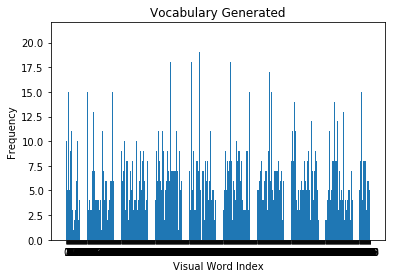

Temps d execution après plot BOV : 1518.53399992 secondes ---
Temps d execution cluster : 1518.53499985 secondes ---
affichage subplot des images liées au cluster 300
-------
204
80
-------


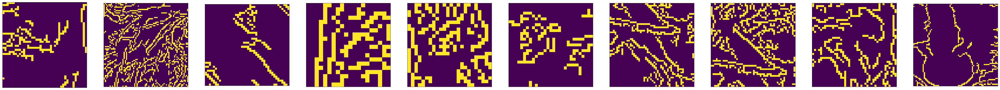

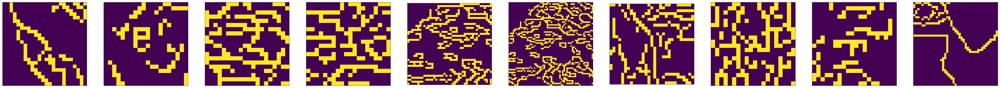

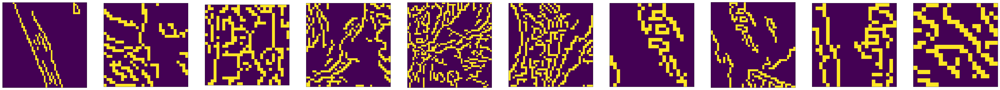

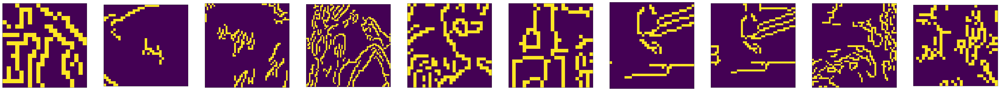

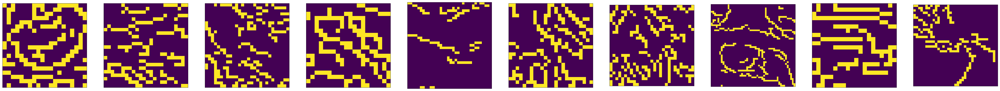

...

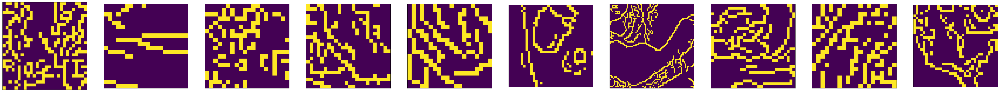

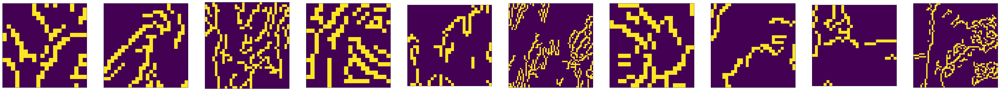

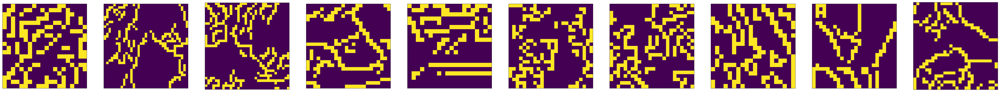

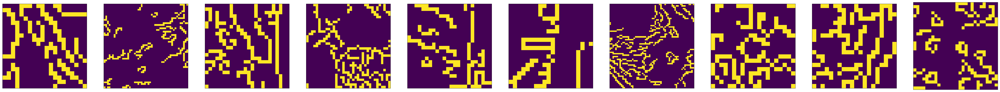

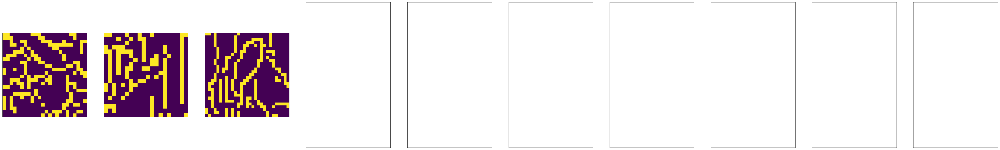

Temps d execution apres subplot : 14.5480000973 secondes ---
--------------------------------- start test cluster 600 ---------------------------------
-----------------------------------------------------------------------------------------
--------------------------------- start test cluster 700 ---------------------------------
Temps d execution apres Clustering : 1742.73699999 secondes ---
Vocabulary Histogram Generated
Temps d execution apres BOV : 1742.74699998 secondes ---
Plotting histogram


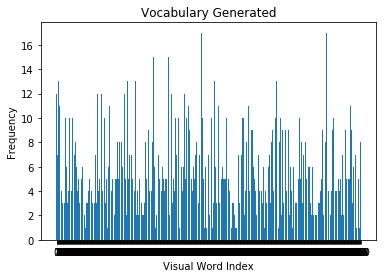

Temps d execution après plot BOV : 1747.59399986 secondes ---
Temps d execution cluster : 1747.59500003 secondes ---
affichage subplot des images liées au cluster 350
-------
168
80
-------


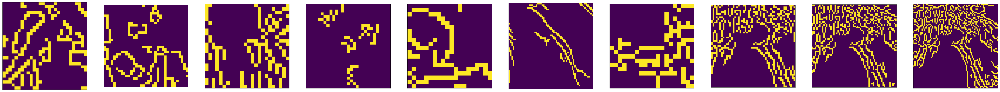

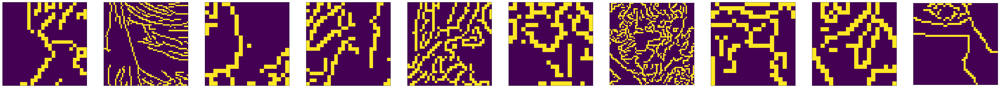

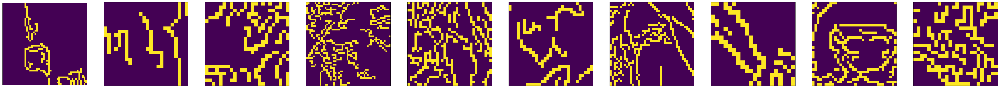

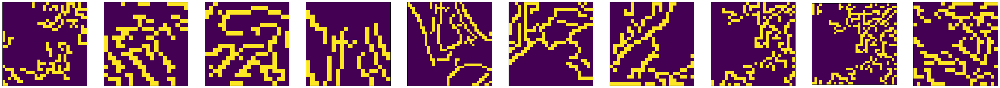

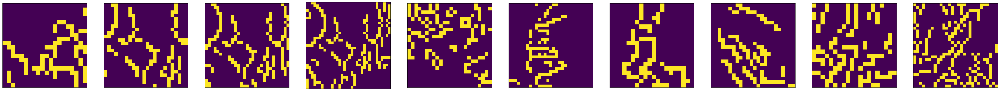

...

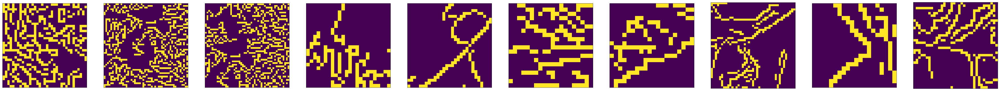

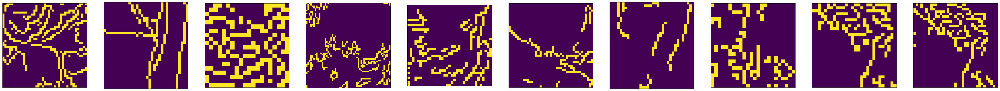

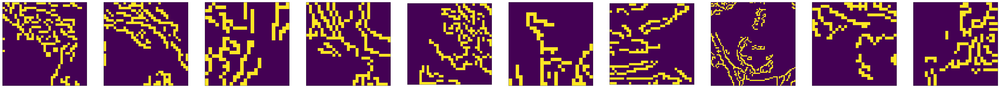

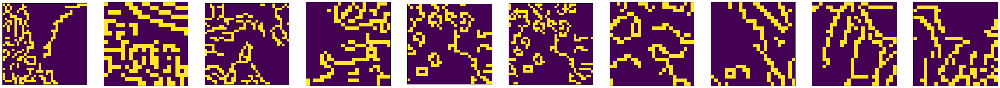

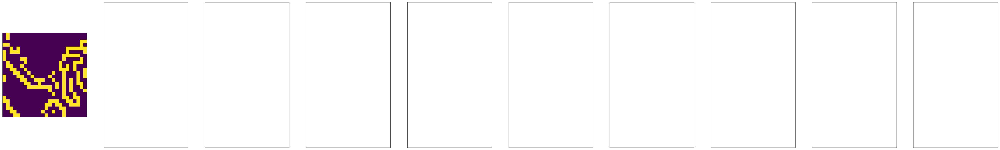

Temps d execution apres subplot : 12.1589999199 secondes ---
--------------------------------- start test cluster 700 ---------------------------------
-----------------------------------------------------------------------------------------
--------------------------------- start test cluster 800 ---------------------------------
Temps d execution apres Clustering : 1944.96199989 secondes ---
Vocabulary Histogram Generated
Temps d execution apres BOV : 1944.97199988 secondes ---
Plotting histogram


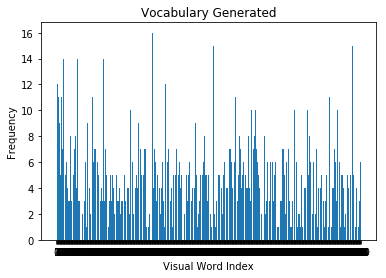

Temps d execution après plot BOV : 1950.43700004 secondes ---
Temps d execution cluster : 1950.43700004 secondes ---
affichage subplot des images liées au cluster 400
-------
240
80
-------


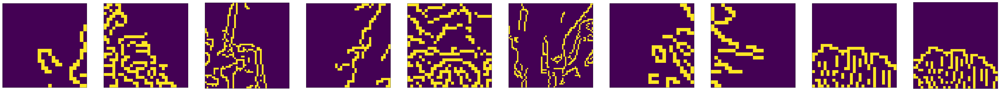

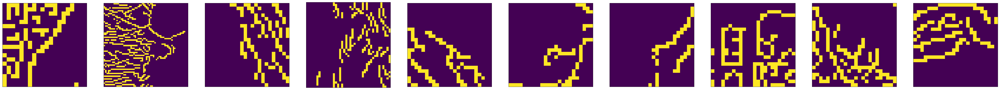

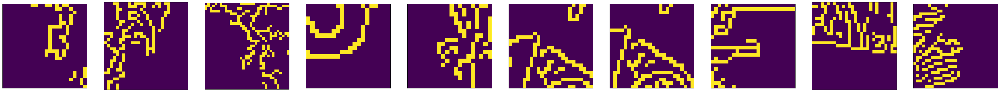

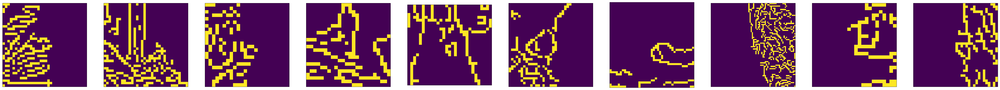

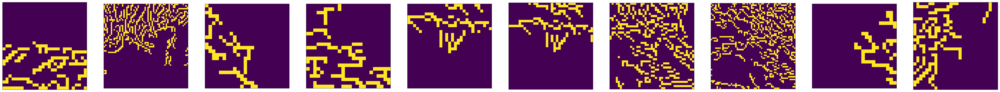

...

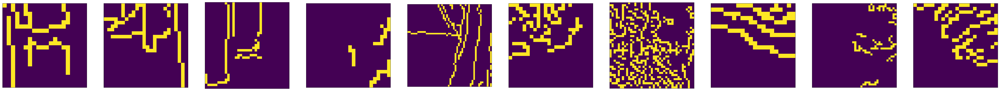

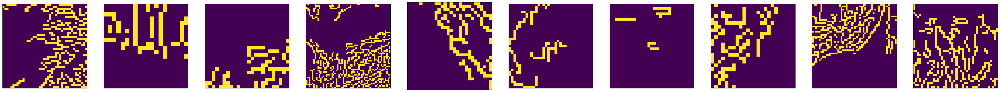

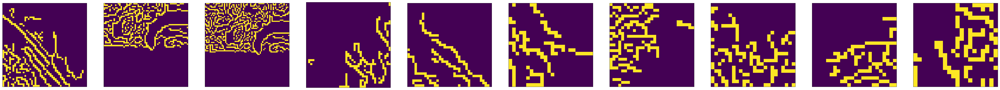

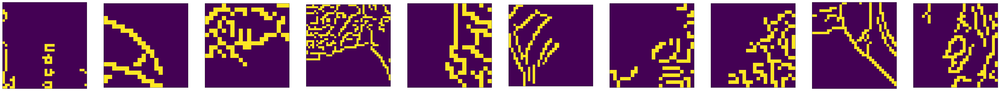

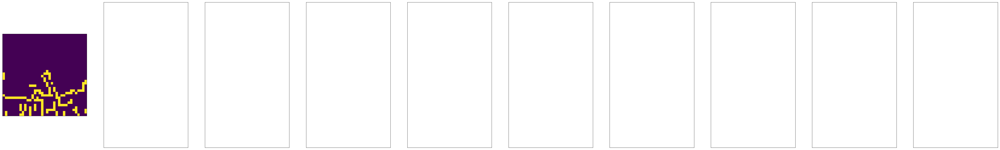

Temps d execution apres subplot : 17.501999855 secondes ---
--------------------------------- start test cluster 800 ---------------------------------
-----------------------------------------------------------------------------------------
--------------------------------- start test cluster 900 ---------------------------------
Temps d execution apres Clustering : 1950.97099996 secondes ---
Vocabulary Histogram Generated
Temps d execution apres BOV : 1950.97899985 secondes ---
Plotting histogram


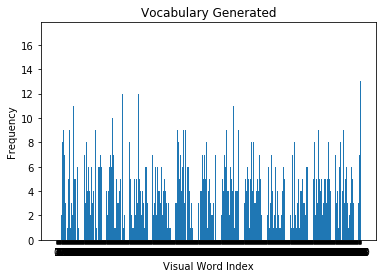

Temps d execution après plot BOV : 1957.25199986 secondes ---
Temps d execution cluster : 1957.25300002 secondes ---
affichage subplot des images liées au cluster 450
-------
192
80
-------


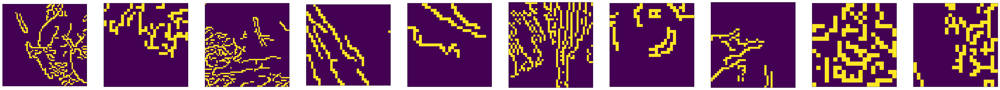

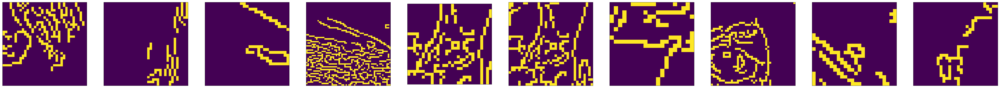

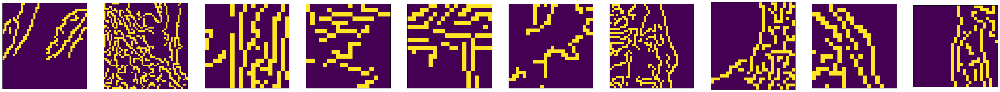

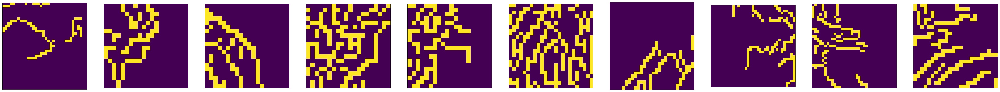

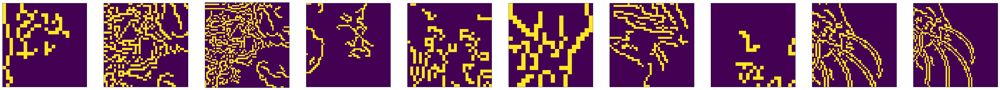

...

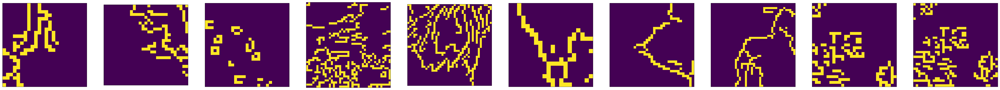

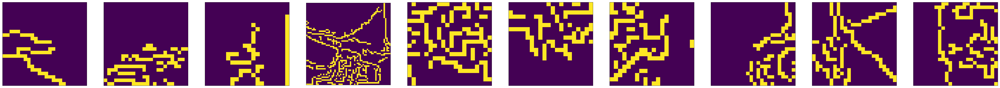

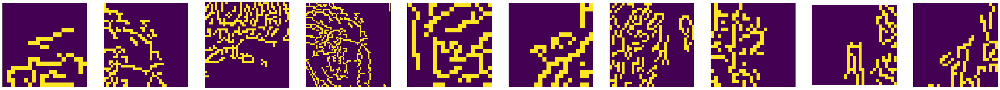

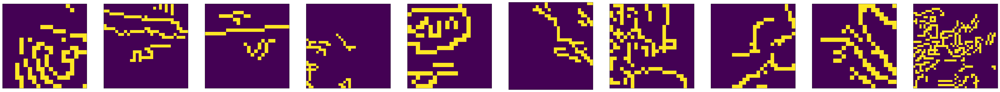

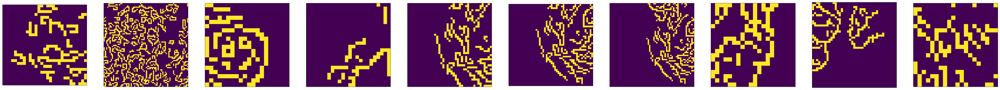

Temps d execution apres subplot : 12.9789998531 secondes ---
--------------------------------- start test cluster 900 ---------------------------------


In [3]:
working_space = 'C:/Users/naru_/OneDrive/Documents/openclassroom/P7 traitement image/'
model = generateModelV2(
        working_directory=working_space,
        number_feature=500,
        number_directory=0, #all
        number_images=2,#20,
        descriptor_generator="ORB",
        minimum_size_descriptor=20
    )

start = 100
stop = 1000
step = 100

for nb_test in range(start, stop, step):
    print("-----------------------------------------------------------------------------------------")
    print("--------------------------------- start test cluster %s ---------------------------------" % str(nb_test))
    generateCluster(
        model,
        number_cluster=nb_test
    )
    showClusterPicture(
        model,
        mode_affichage="subplot",
        number_cluster_to_show=None
      print("--------------------------------- start test cluster %s ---------------------------------" % str(nb_test))

Version : 0.2
Data directory : Data/
Max Number of directory : 0
Max Number of picture by directory : 10
Generator : ORB
Number of feature : 500
Minimum feature size  500
Computing Features for  n02085620-Chihuahua
Computing Features for  n02085782-Japanese_spaniel
Computing Features for  n02085936-Maltese_dog
Computing Features for  n02086079-Pekinese
Computing Features for  n02086240-Shih-Tzu
Computing Features for  n02086646-Blenheim_spaniel
Computing Features for  n02086910-papillon
Computing Features for  n02087046-toy_terrier
Computing Features for  n02087394-Rhodesian_ridgeback
Computing Features for  n02088094-Afghan_hound
Computing Features for  n02088238-basset
Computing Features for  n02088364-beagle
Computing Features for  n02088466-bloodhound
Computing Features for  n02088632-bluetick
Computing Features for  n02089078-black-and-tan_coonhound
Computing Features for  n02089867-Walker_hound
Computing Features for  n02089973-English_foxhound
Computing Features for  n02090379-r

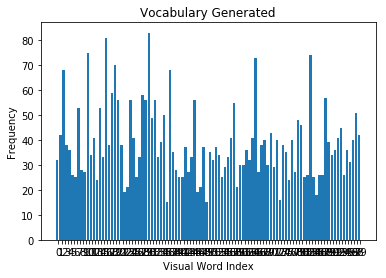

Temps d execution après plot BOV : 2902.58400011 secondes ---
Temps d execution cluster : 2902.58500004 secondes ---
affichage subplot des images liées au cluster 50
-------
6060
80
-------


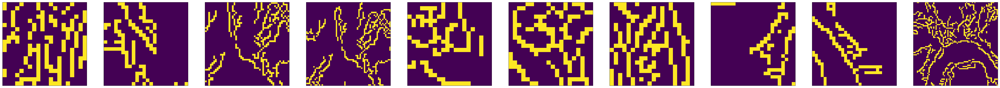

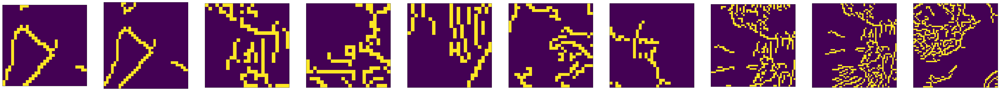

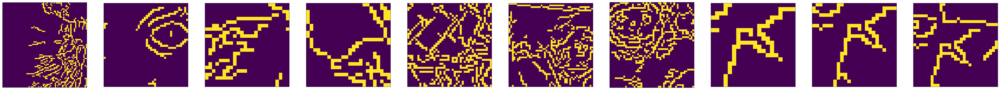

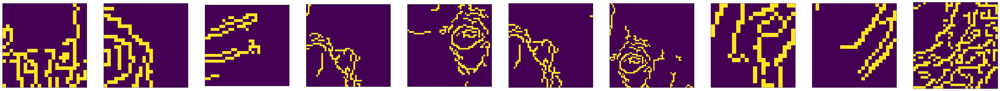

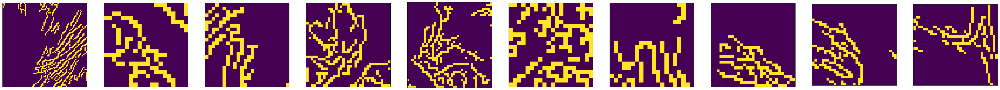

...

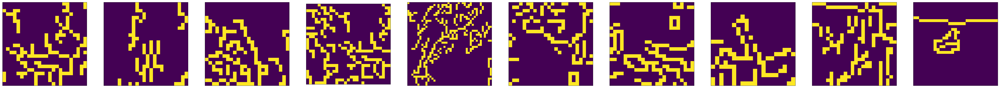

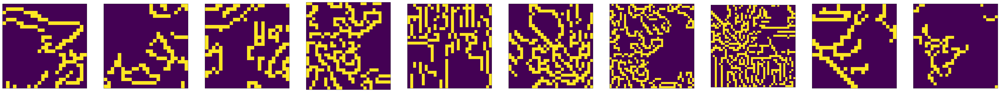

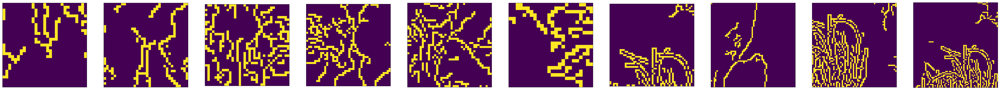

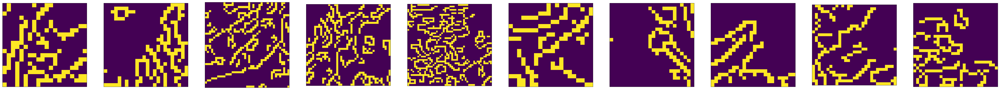

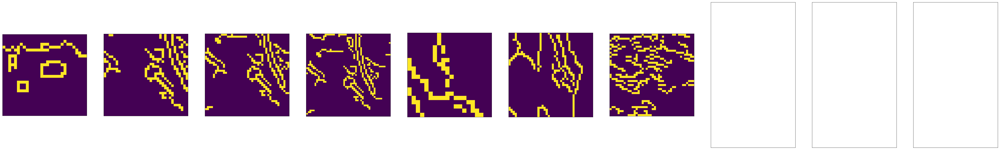

Temps d execution apres subplot : 434.354000092 secondes ---
--------------------------------- start test cluster 100 ---------------------------------
-----------------------------------------------------------------------------------------
--------------------------------- start test cluster 200 ---------------------------------
Temps d execution apres Clustering : 5757.57099986 secondes ---
Vocabulary Histogram Generated
Temps d execution apres BOV : 5757.5769999 secondes ---
Plotting histogram


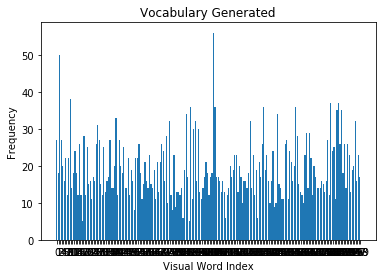

Temps d execution après plot BOV : 5758.954 secondes ---
Temps d execution cluster : 5758.95499992 secondes ---
affichage subplot des images liées au cluster 100
-------
2616
80
-------


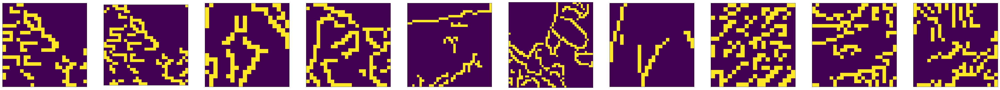

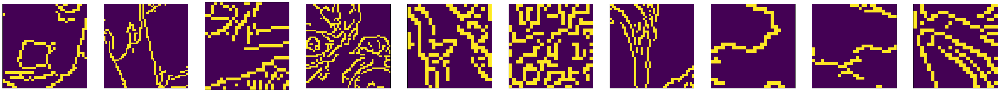

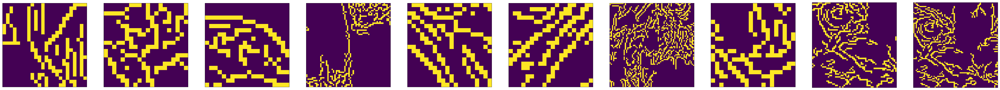

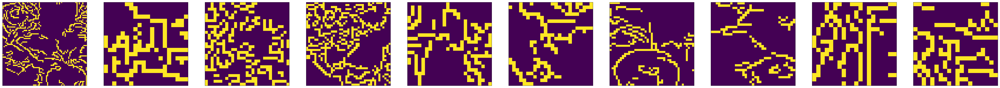

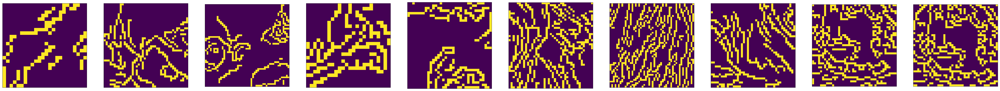

...

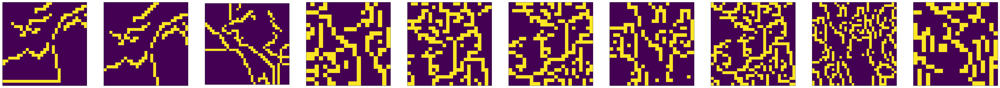

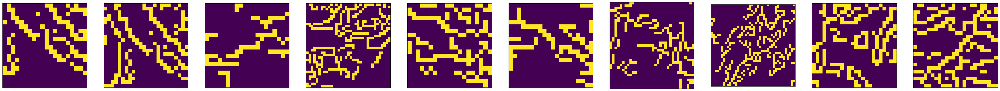

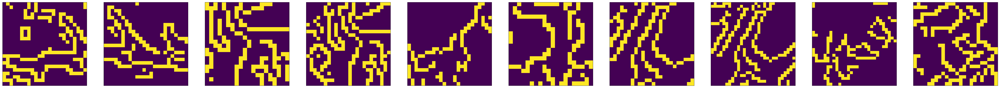

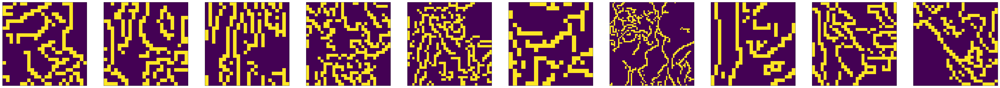

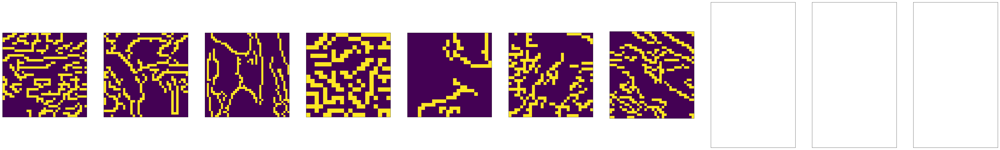

Temps d execution apres subplot : 187.261000156 secondes ---
--------------------------------- start test cluster 200 ---------------------------------
-----------------------------------------------------------------------------------------
--------------------------------- start test cluster 300 ---------------------------------
Temps d execution apres Clustering : 62755.619 secondes ---
Vocabulary Histogram Generated
Temps d execution apres BOV : 62755.7639999 secondes ---
Plotting histogram


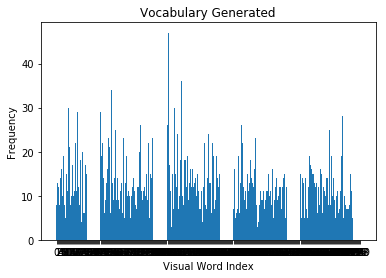

Temps d execution après plot BOV : 62762.352 secondes ---
Temps d execution cluster : 62762.352 secondes ---
affichage subplot des images liées au cluster 150
-------
3072
80
-------


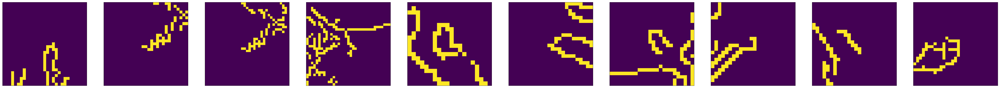

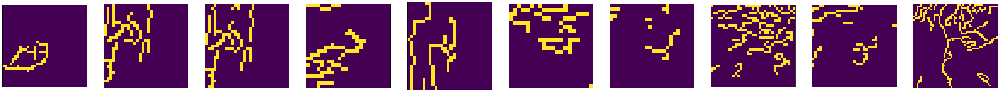

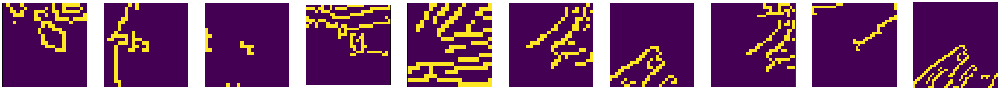

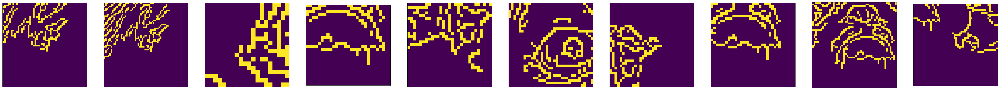

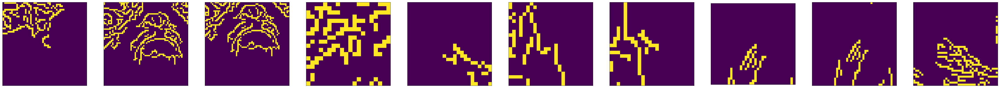

...

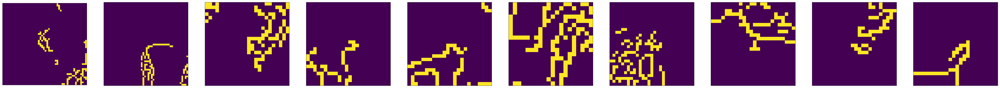

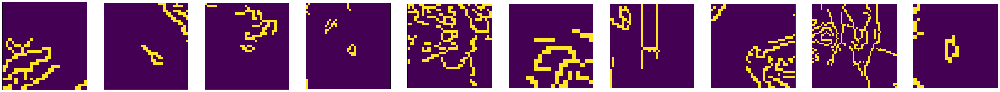

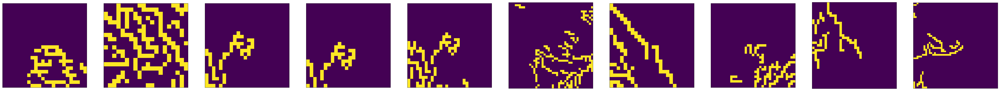

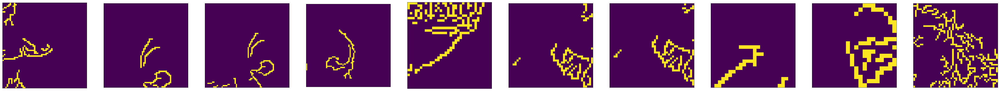

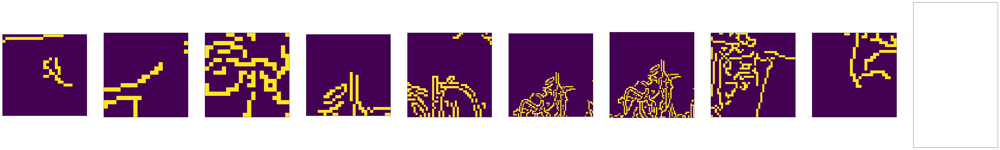

Temps d execution apres subplot : 424.003999949 secondes ---
--------------------------------- start test cluster 300 ---------------------------------
-----------------------------------------------------------------------------------------
--------------------------------- start test cluster 400 ---------------------------------


KeyboardInterrupt: 

In [4]:
del model 

working_space = 'C:/Users/naru_/OneDrive/Documents/openclassroom/P7 traitement image/'
model = generateModelV2(
        working_directory=working_space,
        number_feature=500,
        number_directory=0, #all
        number_images=10,
        descriptor_generator="ORB",
        minimum_size_descriptor=20
    )

start = 100
stop = 1000
step = 100

for nb_test in range(start, stop, step):
    print("-----------------------------------------------------------------------------------------")
    print("--------------------------------- start test cluster %s ---------------------------------" % str(nb_test))
    generateCluster(
        model,
        number_cluster=nb_test
    )
    showClusterPicture(
        model,
        mode_affichage="subplot",
        number_cluster_to_show=None
    )
    print("--------------------------------- start test cluster %s ---------------------------------" % str(nb_test))

Version : 0.3
Data directory : Data/
Max Number of directory : 0
Max Number of picture by directory : 2
Generator : ORB
Number of feature : 500
Minimum feature size  500
Computing Features for  n02085620-Chihuahua
Computing Features for  n02085782-Japanese_spaniel
Computing Features for  n02085936-Maltese_dog
Computing Features for  n02086079-Pekinese
Computing Features for  n02086240-Shih-Tzu
Computing Features for  n02086646-Blenheim_spaniel
Computing Features for  n02086910-papillon
Computing Features for  n02087046-toy_terrier
Computing Features for  n02087394-Rhodesian_ridgeback
Computing Features for  n02088094-Afghan_hound
Computing Features for  n02088238-basset
Computing Features for  n02088364-beagle
Computing Features for  n02088466-bloodhound
Computing Features for  n02088632-bluetick
Computing Features for  n02089078-black-and-tan_coonhound
Computing Features for  n02089867-Walker_hound
Computing Features for  n02089973-English_foxhound
Computing Features for  n02090379-re

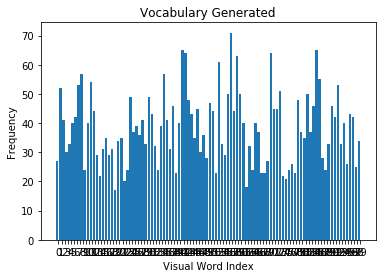

Temps d execution après plot BOV : 599.284000158 secondes ---
Temps d execution cluster : 599.285000086 secondes ---
affichage subplot des images liées au cluster 50
-------
1632
80
-------


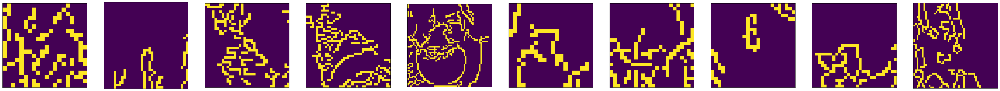

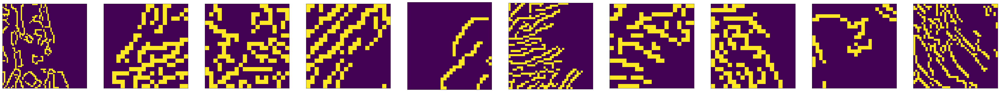

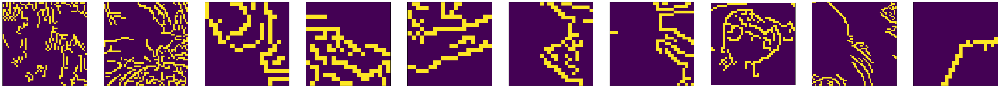

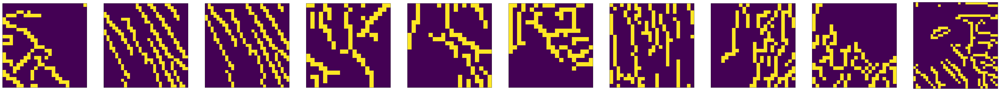

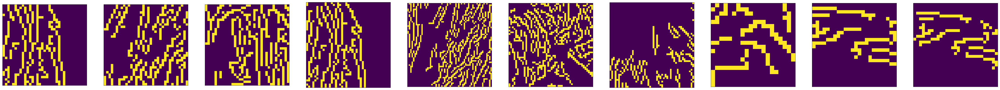

...

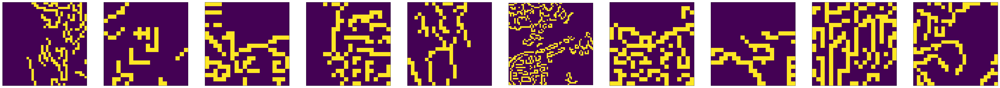

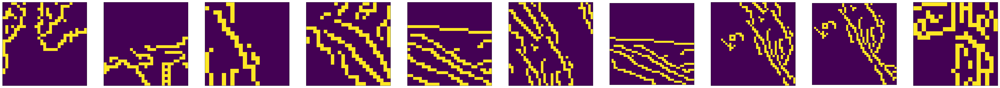

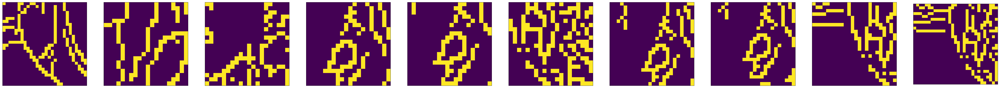

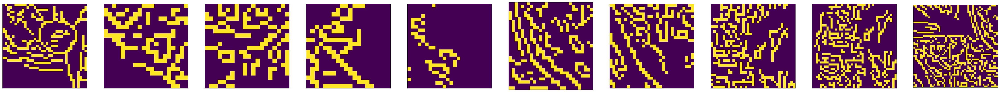

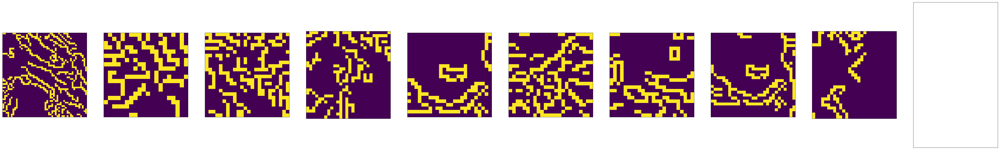

Temps d execution apres subplot : 192.289000034 secondes ---
--------------------------------- start test cluster 100 ---------------------------------
-----------------------------------------------------------------------------------------
--------------------------------- start test cluster 200 ---------------------------------
Temps d execution apres Clustering : 1083.69999981 secondes ---
Vocabulary Histogram Generated
Temps d execution apres BOV : 1083.71299982 secondes ---
Plotting histogram


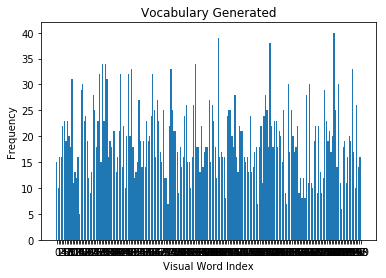

Temps d execution après plot BOV : 1086.58699989 secondes ---
Temps d execution cluster : 1086.58999991 secondes ---
affichage subplot des images liées au cluster 100
-------
828
80
-------


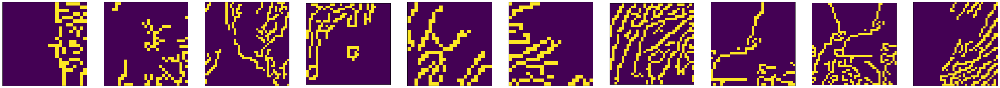

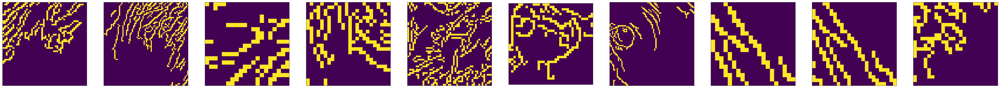

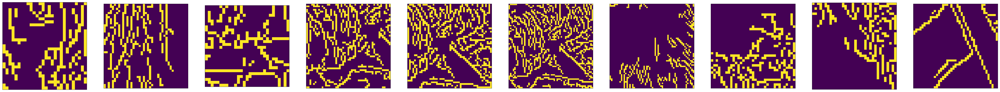

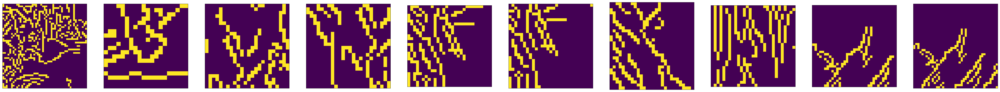

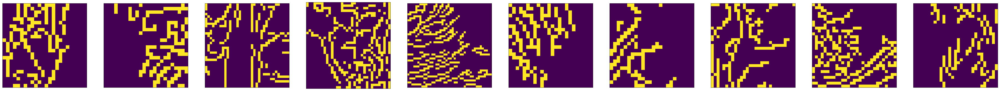

...

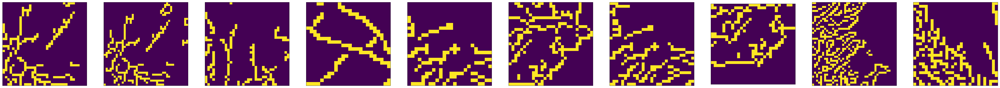

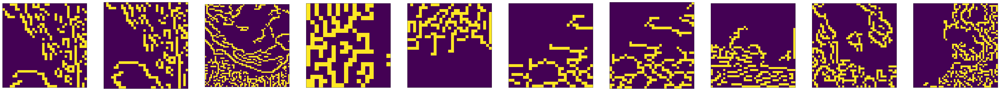

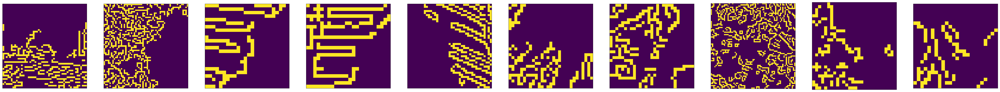

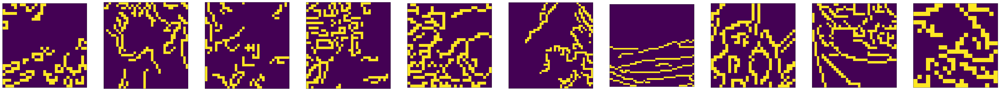

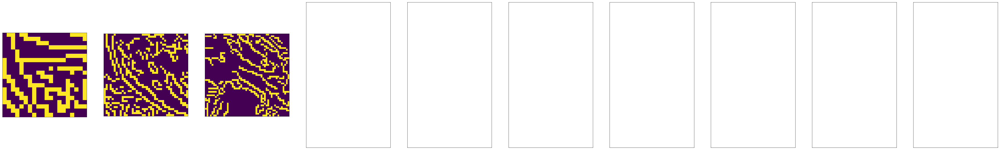

Temps d execution apres subplot : 100.759000063 secondes ---
--------------------------------- start test cluster 200 ---------------------------------
-----------------------------------------------------------------------------------------
--------------------------------- start test cluster 300 ---------------------------------


In [ ]:
#del model 

working_space = 'C:/Users/naru_/OneDrive/Documents/openclassroom/P7 traitement image/'
model = generateModelV2(
        working_directory=working_space,
        number_feature=500,
        number_directory=0, #all
        number_images=2,
        descriptor_generator="ORB",
        minimum_size_descriptor=20
    )

start = 100
stop = 1000
step = 100

for nb_test in range(start, stop, step):
    print("-----------------------------------------------------------------------------------------")
    print("--------------------------------- start test cluster %s ---------------------------------" % str(nb_test))
    generateCluster(
        model,
        number_cluster=nb_test
    )
    showClusterPicture(
        model,
        mode_affichage="subplot",
        number_cluster_to_show=None
    )
    print("--------------------------------- start test cluster %s ---------------------------------" % str(nb_test))

In [6]:
del model 

working_space = 'C:/Users/naru_/OneDrive/Documents/openclassroom/P7 traitement image/'
model = generateModelV2(
        working_directory=working_space,
        number_feature=500,
        number_directory=0, #all
        number_images=10,
        descriptor_generator="ORB",
        minimum_size_descriptor=20
    )

start = 1000
stop = 100
step = -100

for nb_test in range(start, stop, step):
    print("-----------------------------------------------------------------------------------------")
    print("--------------------------------- start test cluster %s ---------------------------------" % str(nb_test))
    generateCluster(
        model,
        number_cluster=nb_test
    )
    showClusterPicture(
        model,
        mode_affichage="subplot",
        number_cluster_to_show=None
    )
    print("--------------------------------- start test cluster %s ---------------------------------" % str(nb_test))

[1000, 900, 800, 700, 600, 500, 400, 300, 200]